# Online News Popularity Classification
## -model fitting and selection

### Xian Lai
xlai4@fordham.edu

=======================================================
<img src="title_image_0.png" width="1200">

### Data set:
With the dataset been cleaned and standarized. We now put them into models.

In [1]:
import pandas as pd
import numpy as np
import pickle
from copy import deepcopy

from sklearn.model_selection import KFold, ParameterGrid 
import sklearn.preprocessing as prep
from sklearn.decomposition import PCA, SparsePCA, FactorAnalysis, NMF
from sklearn.linear_model import LogisticRegression as lr
from sklearn.svm import SVC as svc
from sklearn.neighbors import KNeighborsClassifier as knn
from sklearn.ensemble import RandomForestClassifier as rf

from xgboost import XGBClassifier as xgb

import sys; sys.path.append('modules')
import _visual as vis
from _KDE_naive_bayes import KDENB as nb
import _feature_selection as fs

/Users/LAI/anaconda/envs/xgboost/lib/python3.6/site-packages/sklearn/cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
X_train_ori = np.fromfile('data/clean_dataset/x_train_ori').reshape((27000, 47))
X_test_ori = np.fromfile('data/clean_dataset/x_test_ori').reshape((8216, 47))
X_train_pca = np.fromfile('data/clean_dataset/x_train_pca').reshape((27000, 47))
X_test_pca = np.fromfile('data/clean_dataset/x_test_pca').reshape((8216, 47))
X_train_spca = np.fromfile('data/clean_dataset/x_train_spca').reshape((27000, 30))
X_test_spca = np.fromfile('data/clean_dataset/x_test_spca').reshape((8216, 30))
X_train_fa = np.fromfile('data/clean_dataset/x_train_fa').reshape((27000, 25))
X_test_fa = np.fromfile('data/clean_dataset/x_test_fa').reshape((8216, 25))
X_train_nmf = np.fromfile('data/clean_dataset/x_train_nmf').reshape((27000, 15))
X_test_nmf = np.fromfile('data/clean_dataset/x_test_nmf').reshape((8216, 15))

y_train = np.fromfile('data/clean_dataset/y_train', dtype=int).reshape((-1, 1))
y_test = np.fromfile('data/clean_dataset/y_test', dtype=int).reshape((-1, 1))

# 0. Pre-setting

In the rest part of project, I will test **6 classifiers**:

    1. Naive Bayes
    2. Logistic Regression
    3. SVM
    4. k-Nearest Neighbours
    5. Random Forest
    6. XGBoost

In different **Feature spaces**:

    1. original
    2. PCA
    3. sparsePCA
    4. FactorAnalysis
    5. NMF
    
### Model optimization:

To tune the parameters and optimize each of the classifier, I will test each parameter combination on the training set using 5-fold cross validation to avoid overfitting. 

### Performance Evaluation:

As explained with great detail in "Pattern Recognition and Machine Learning" (Bishop, 2011), the expected error can be expressed as:

$$Error = Bias^2 + Variance + (Noise)$$

In which the squared bias is the distance from expectation of prediction to the target value. In the case of classification, the distance from target value to correct prediction is 0 and to wrong prediction is 1. Since we are using 5-fold cross validation, $bias = mean(1 - accuracy) = 1 - mean(accuracy)$. And the variance is $var(accuracy)$.

\*Because the noise term discribes the noise come with the data set, it is not reducible by tuning model, we don't consider it in the performance evaluation. 

In [3]:
clf_name = ['Naive Bayes', 'Logistic Regression', 'SVM', 'k-Nearest Neighbours', 'Random Forest', 'XGBoost']

space_name = ['original', 'PCA', 'sparsePCA', 'factorAnalysis', 'NMF']
X_train_space = {0:X_train_ori, 1:X_train_pca, 2:X_train_spca, 3:X_train_fa, 4:X_train_nmf}
X_test_space = {0:X_test_ori, 1:X_test_pca, 2:X_test_spca, 3:X_test_fa, 4:X_test_nmf}

kf_5 = KFold(n_splits=5)

perf_evaluations = [] # the nested lists that keeps track of performance evaluations

In [4]:
# global functions
def evaluate_performance(clf, param, cv, X, Y, clf_name, space_name, silent=False):
    """Evaluate the performance of an assigned classifier in an assigned feature space. 
    The evaluation stats are mean, var and expected loss calculated from assigned cross validation.
    """
    perfs = []
    for train_idx, test_idx in cv.split(X):
        model = clf(**param)
        model.fit(X[train_idx], Y[train_idx].ravel())
        perfs.append(model.score(X[test_idx], Y[test_idx].ravel()))

    bias = 1 - np.mean(perfs)
    var = np.var(perfs)
    loss = bias**2 + var
    
    if not silent:
        print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
              (clf_name, space_name, bias, var, loss))
    return bias, var, loss
      
def visuallize_tuning(grp, grp_idx, space_name):
    """Visuallize the parameter tuning results by parallel coordinates plotting.
    """
    perfs = grp.get_group(grp_idx).drop('spa', axis=1)
    v = vis.Visual(1, 1, figsize=(12, 6))
    v.parallel_coordinates(perfs, 'loss', space_name, show=False)
    return v

def visuallize_decision_boundary(clf, X, Y, param, feat_idx):
    """Visuallize the decision boundaries made by assigned classifier in assigned feature space 
    on assigned 2 features.
    """
    models = [clf(), clf(**param)]
    X_plot = X[:,feat_idx]

    v = vis.Visual(1, 2, figsize=(18, 9))
    v.decision_contour(X_plot, Y, models, feat_idx[0], feat_idx[1], alpha_sca=0.3, show=False)
    return v
    
def map_index(df, params):
    """Map the values of dataframe to its corresponding index in the parameter dictionary 
    keyed by the same name as column name.
    """
    for col in df.columns:
        if col in params.keys():
            df[col] = df[col].apply(lambda x: params[col].index(x))
    return df

def tune_model(clf, params, X_s, Y):
    """Tune the assigned model by grid searching through combinations of given parameter values
    in all 5 spaces. Record all the parameter combinations and corresponding expected losses as
    a dataframe.
    """
    param_grid = ParameterGrid(params)
    list_results = []
    
    for spa in range(5):
        for i in range(len(param_grid)):
            bias, var, loss = evaluate_performance(clf, param_grid[i], kf_5, X_s[spa], Y, None, None, silent=False)
            result = list(param_grid[i].values())
            result.extend([spa, bias, var, loss])
            list_results.append(result)
            print(spa, i)
    
    cols = list(param_grid[0].keys())
    cols.extend(['spa', 'bias', 'var', 'loss'])
    df_results = pd.DataFrame(list_results, columns=cols)
    df_results = map_index(df_results, params)
    
    return df_results.sort_values('loss').reset_index(drop=True)

def feature_removal(X, Y, path):
    selection = fs.FeatureRemoval(X, Y, nb)
    selection.select()
    result = {'criteria':selection.criteria,
              'n_feats':selection.n_feats,
              'selections':selection.selections}
    sel = pd.DataFrame(result)
    sel.to_pickle(path)

# 1. naive_bayes:

We start with the simple generative model naive Bayes. As we can see in feature histograms below, each feature has slightly different distributions in different classes. So it makes sense to use this classifier.

But there are more than 1 type of distributions for each of these features. Some of them are normal, some of them are exponential and there are even ones not typical and multimodal, especially those in original feature space. So we can't directly use Gaussian naive Bayes or Bernoulli naive Bayes. To accommodate various types of distributions, I implemented a naive Bayes classifier using Gaussian KDE as distribution estimator.

## Feature selection and Performance Evaluation:

To reduce the effect of overfitting and improve the performance, we can remove the possible irrelevant features. The problem here is which features are less-informative and how many of them should be removed.

For original features, we don't have a order of relevance of features, thus we have to try removing every one of them until we get the best result.

### a. original feature space:

accuracy = 0.5638
accuracy = 0.5638


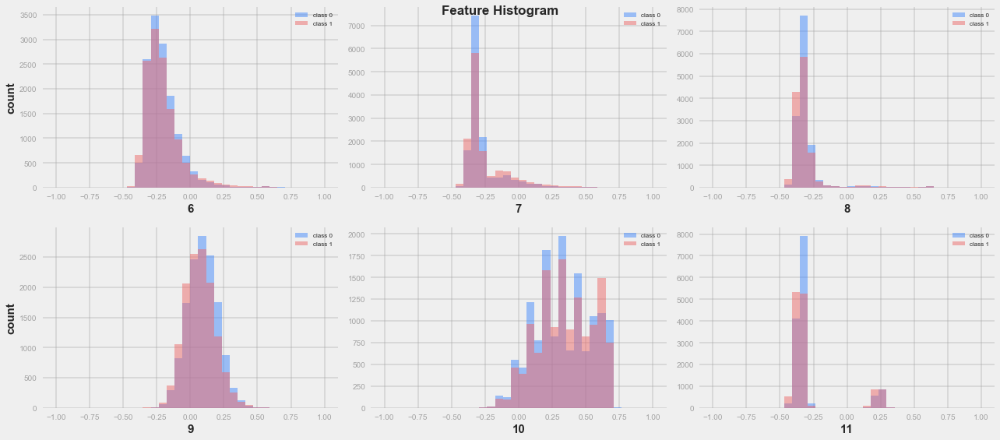

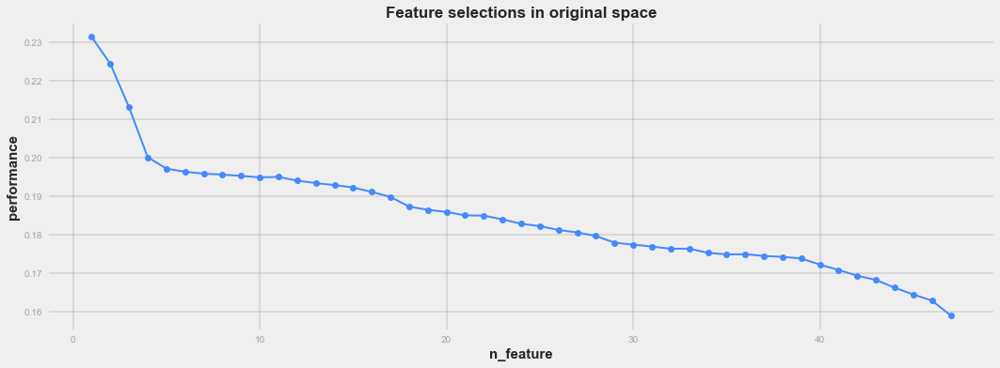

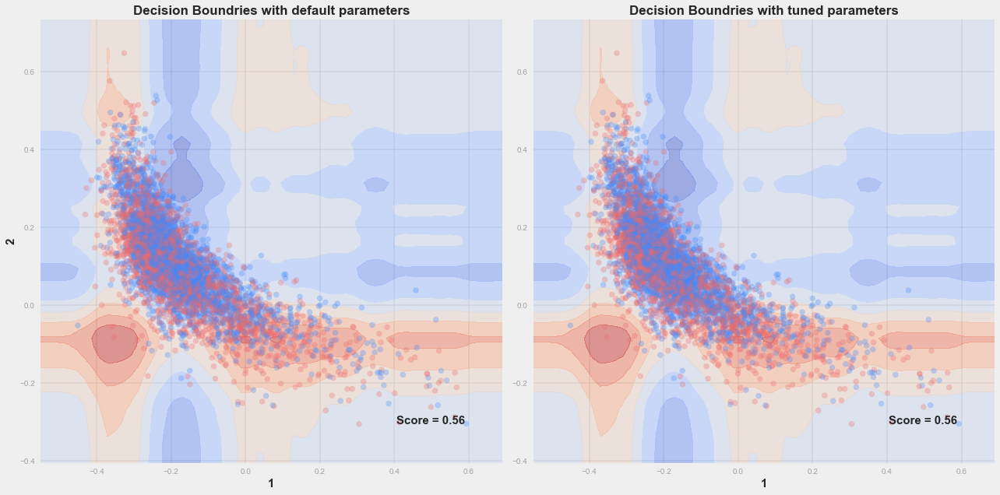

In [5]:
v1 = vis.Visual(2, 3, figsize=(18, 8))
v1.hists(X_train_space[0], y_train, list(range(6,12)), bin_num=35, show=False)

"""* Due to the large amount of time needed for feature selection, I will directly 
import the results generated by the following code. So as the other feature selection 
and parameter tuning steps.

feature_removal(X_train_space[0], y_train, 'data/performances/perfs_nb_ori')
"""
df_perf_nb_ori = pd.read_pickle('data/performances/perfs_nb_ori')

v2 = vis.Visual(1, 1, figsize=(18, 6))
v2.line(df_perf_nb_ori['n_feats'], df_perf_nb_ori['criteria'], 'n_feature', 'performance', 
       'Feature selections in original space', show=False)
v3 = visuallize_decision_boundary(nb, X_train_space[0][:5000], y_train[:5000], {}, [1,2])
vis.plt.show()
perf_evaluations.append([None, None, df_perf_nb_ori.loc[0, 'criteria']])

As we can see in the feature selection plotting, the expected loss keeps growing as the features being removed. So considering both accuracy and stableness, we'd better use all features.

### b. PCA feature space:

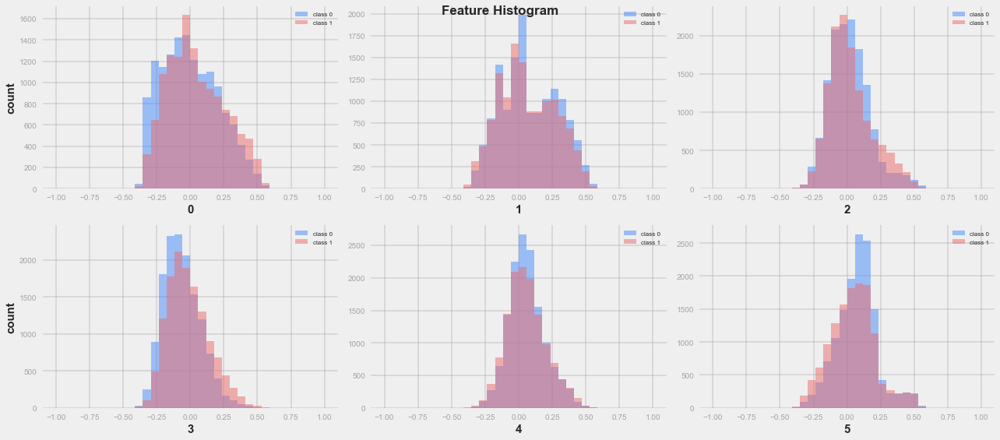

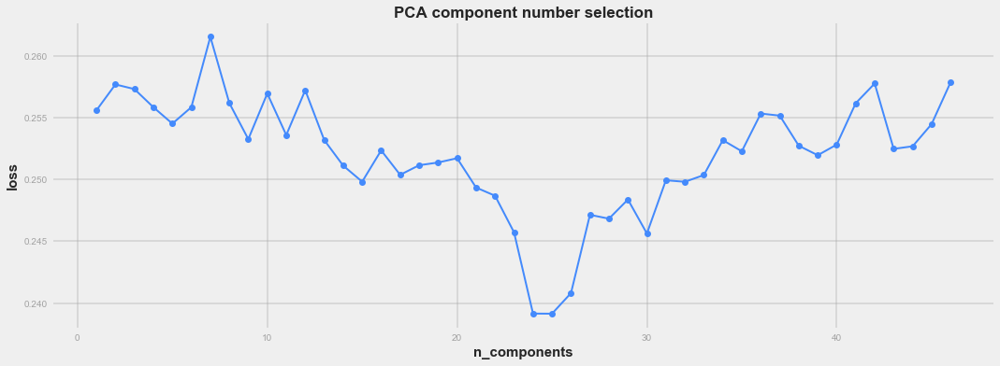

accuracy = 0.542
accuracy = 0.542


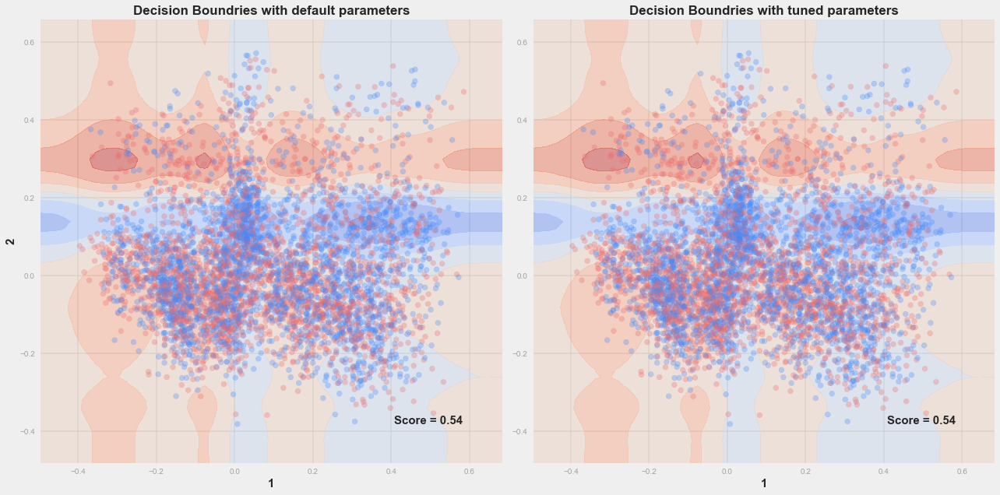

In [6]:
v1 = vis.Visual(2, 3, figsize=(18, 8))
v1.hists(X_train_space[1], y_train, list(range(0,6)), bin_num=35, show=False)

"""
arr_perf_nb_pca = np.empty((len(range(1, 47)), 4))

for i in range(1, 47):
    X_train_slt = X_space[1][:, :i]
    bias, var, loss = evaluate_performance(nb, {}, kf_3, X_train_slt, Y_train, clf_name[1], 'PCA')
    arr_perf_nb_pca[(i-1),:] = i, bias, var, loss

df_perf_nb_pca = pd.DataFrame(arr_perf_nb_pca, columns=['comp_n', 'bias', 'var', 'loss'])
df_perf_nb_pca.to_csv('data/performances/perfs_nb_pca.csv', index=False)
"""
df_perf_nb_pca = pd.read_csv('data/performances/perfs_nb_pca.csv')

v2 = vis.Visual(1, 1, figsize=(18, 6))
v2.line(df_perf_nb_pca['comp_n'], df_perf_nb_pca['loss'], 'n_components', 'loss',
       'PCA component number selection')
v3 = visuallize_decision_boundary(nb, X_train_space[1][:5000], y_train[:5000], {}, [1,2])
vis.plt.show()

stats = list(df_perf_nb_pca.loc[df_perf_nb_pca['comp_n']==24.0, ['bias', 'var', 'loss']].values[0])
perf_evaluations.append(stats)

In PCA the components are ranked by preserved variance ratio. Thus we can select the right number of components by removing one at a time from the end and compare the result performance.

When the number of components go up to 24 and 25, the expected loss reaches the valley bottom and then goes up again. 

But in PCA space, naive Bayes classifier gives a much worse performance.(0.24 compared to previous 0.16 in original space)

### c. sparse PCA feature space:

accuracy = 0.564
accuracy = 0.564


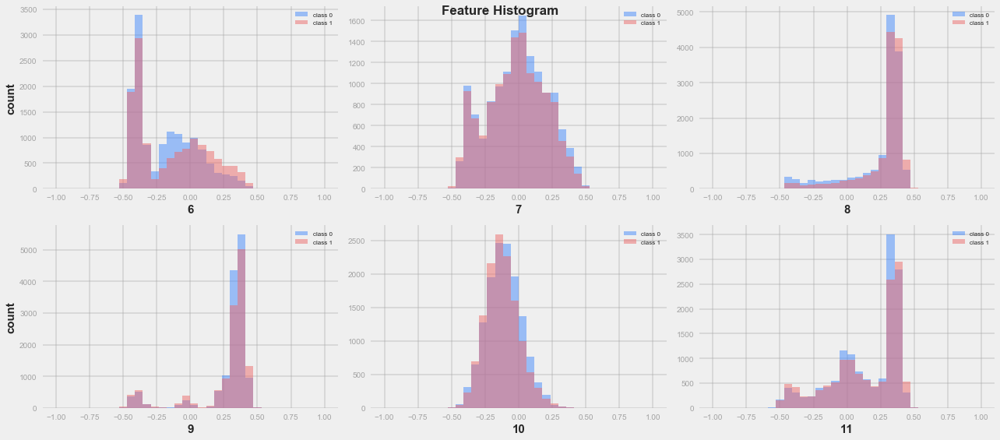

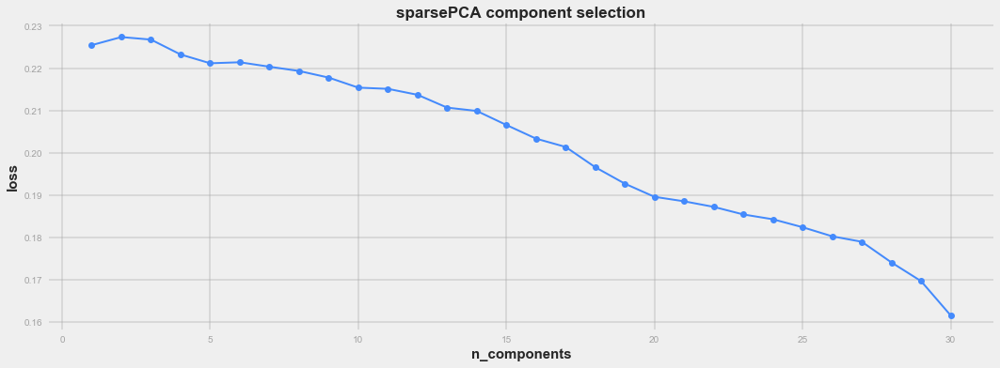

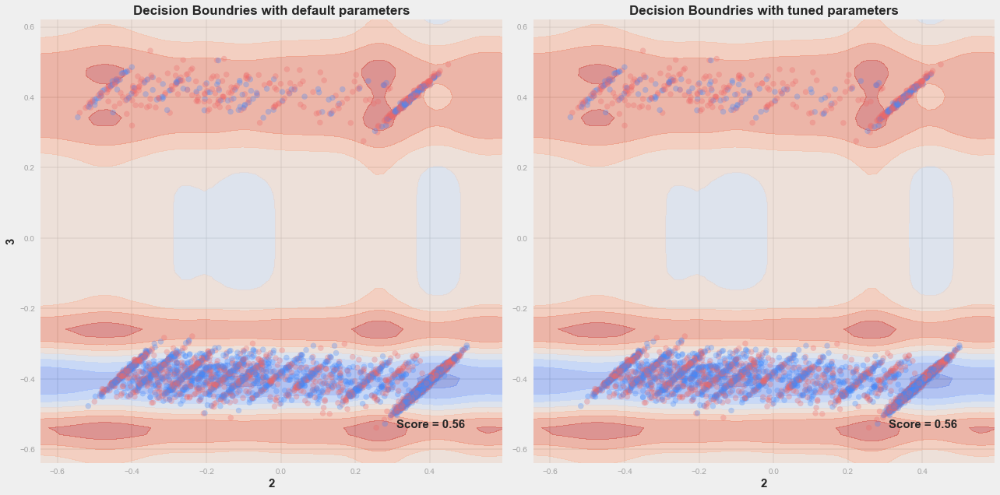

In [7]:
v1 = vis.Visual(2, 3, figsize=(18, 8))
v1.hists(X_train_space[2], y_train, list(range(6,12)), bin_num=35, show=False)

"""feature_removal(X_train_space[2], y_train, 'data/performances/perfs_nb_spca')"""
df_perf_nb_spca = pd.read_pickle('data/performances/perfs_nb_spca')

v2 = vis.Visual(1, 1, figsize=(18, 6))
v2.line(df_perf_nb_spca['n_feats'], df_perf_nb_spca['criteria'], 'n_components', 'loss',
       'sparsePCA component selection', show=False)
v3 = visuallize_decision_boundary(nb, X_train_space[2][:5000], y_train[:5000], {}, [2,3])
vis.plt.show()

perf_evaluations.append([None, None, df_perf_nb_spca.loc[0, 'criteria']])

In sparse PCA space, the performance are slightly worse than that in original space and better than in PCA space. But from decision boundaries plotting, we can see it classified most of the data points into class_0, thus it didn't really learn the pattern.

### d. factor analysis feature space:

accuracy = 0.565
accuracy = 0.565


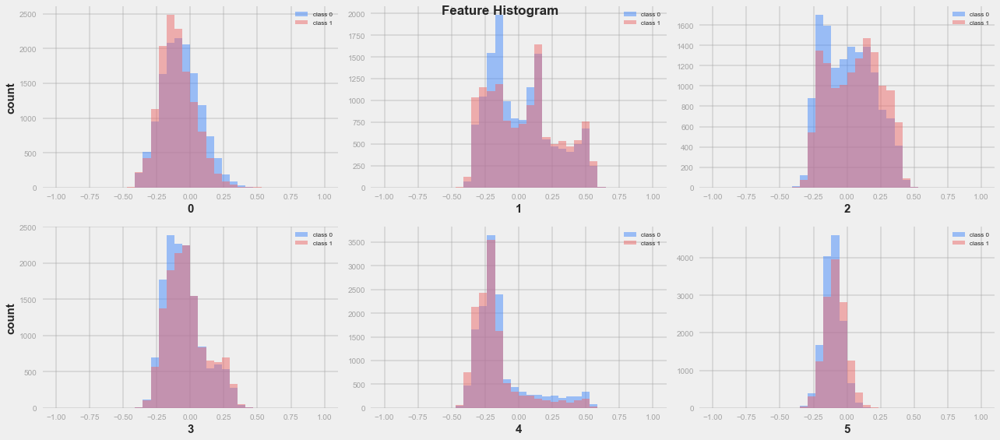

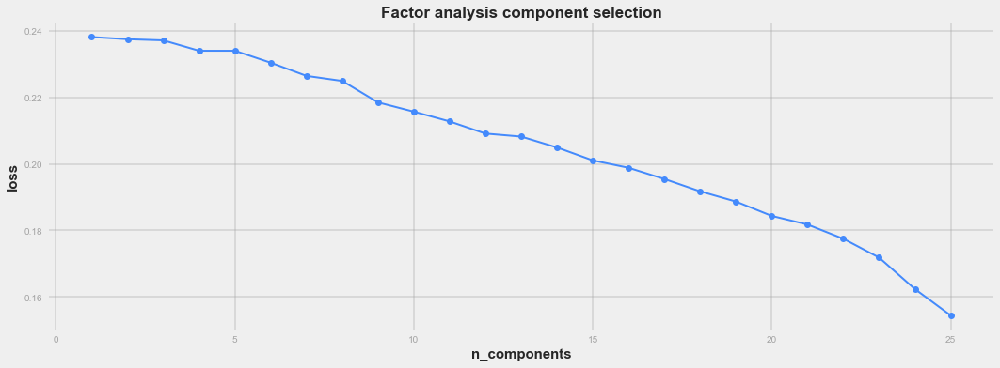

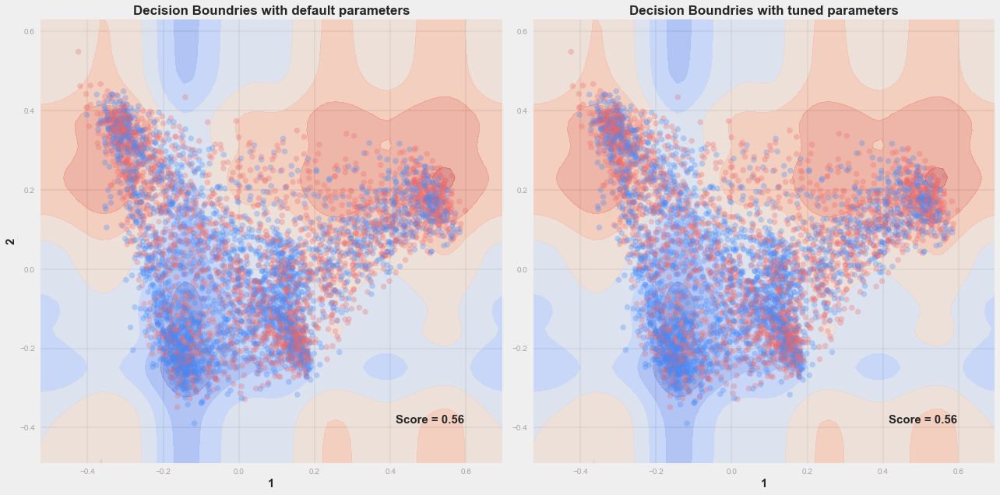

In [8]:
v1 = vis.Visual(2, 3, figsize=(18, 8))
v1.hists(X_train_space[3], y_train, list(range(0,6)), bin_num=35, show=False)

"""feature_removal(X_train_space[3], y_train, 'data/performances/perfs_nb_fa1')"""
df_perf_nb_fa = pd.read_pickle('data/performances/perfs_nb_fa')

v2 = vis.Visual(1, 1, figsize=(18, 6))
v2.line(df_perf_nb_fa['n_feats'], df_perf_nb_fa['criteria'], 'n_components', 'loss',
       'Factor analysis component selection', show=False)
v3 = visuallize_decision_boundary(nb, X_train_space[3][:5000], y_train[:5000], {}, [1,2])
vis.plt.show()

perf_evaluations.append([None, None, df_perf_nb_fa.loc[0, 'criteria']])

### e. NMF feature space:

accuracy = 0.575
accuracy = 0.575


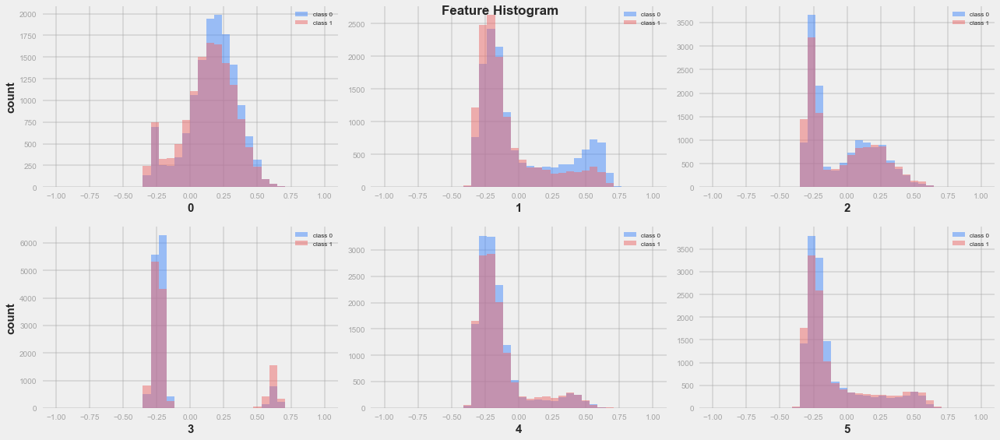

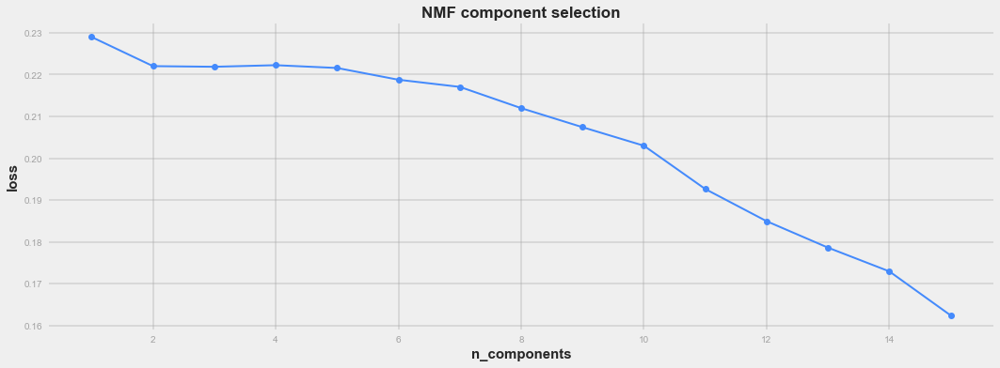

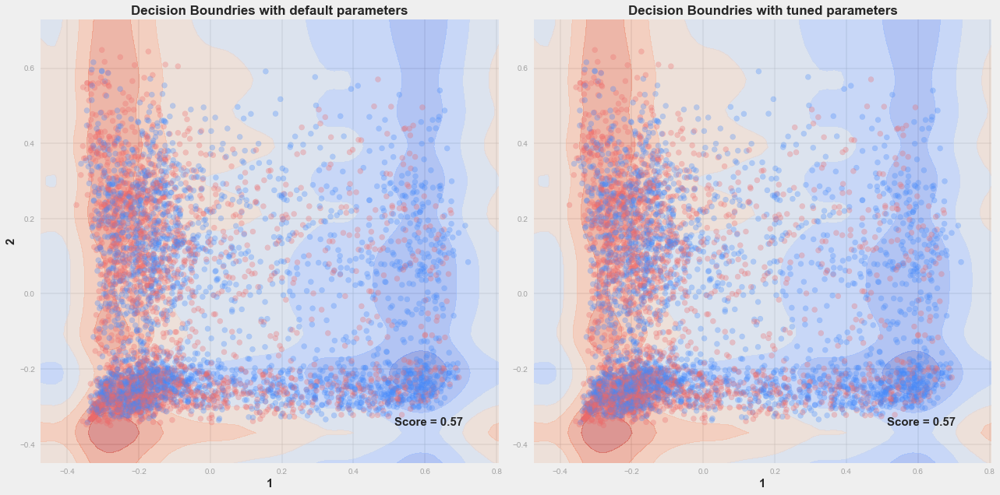

In [9]:
v1 = vis.Visual(2, 3, figsize=(18, 8))
v1.hists(X_train_space[4], y_train, list(range(0,6)), bin_num=35, show=False)

"""feature_removal(X_space[4], Y, 'data/performances/perfs_nb_nmf')"""
df_perf_nb_nmf = pd.read_pickle('data/performances/perfs_nb_nmf')

v = vis.Visual(1, 1, figsize=(18, 6))
v.line(df_perf_nb_nmf['n_feats'], df_perf_nb_nmf['criteria'], 'n_components', 
       'loss', 'NMF component selection', show=False)
v2 = visuallize_decision_boundary(nb, X_train_space[4][:5000], y_train[:5000], {}, [1,2])
vis.plt.show()

perf_evaluations.append([None, None, df_perf_nb_nmf.loc[0, 'criteria']])

In general, naive Bayes is a relatively simple generative model. It simplifies and factorizes the joint distribution into the product of distributions of each single random variable, thus the decision boundarys are always distributed paralell to axes. 

In our case, the classes are highly mixed, this classifier is not powerful enough to separate them.

# 2. Logistic Regression:

Next we move on to the simple discriminative classifier logistic regression. We will test how this low capacity model works on our data set and then go on to other higher-capacity families of models. 

From the scatter plots in feature engineering section we can tell the data points in any of those 5 spaces are not linear separable. In order to draw non-linear decision boundary and incorporate possible relationships between pairs of features, we can map the features into higher dimensional polynomial space. In this project, we will set degree equals 2.(We will test the situation of degree=3 with polynomial kernel in support vector machine)

In [10]:
X_train_polyspace = {}
X_test_polyspace = {}

for i in range(5):
    poly = prep.PolynomialFeatures(2)
    X_train_polyspace[i] = poly.fit_transform(X_train_space[i])
    X_test_polyspace[i] = poly.fit_transform(X_test_space[i])

### Baseline performance with default setting:

When we input polynomially transformed data directly into logistic regression classifier with default parameter setting: {'penalty':'l2', 'C':1.0}. 

The result is promising, even this discriminative classifier is simple, it already yields a much better result compared to naive Bayes.

In [11]:
bias, var, loss = evaluate_performance(lr, {}, kf_5, X_train_polyspace[0], y_train, clf_name[1], 
                                       'polynomially original')


The performance evaluation of Logistic Regression with polynomially original features are
bias:0.343
var:0.000023
expected loss:0.117393


## Tune model in different feature space:

Grid search is performed on parameters:
    
    1. Regularization type(penalty): ['l1', 'l2']
    2. Regularization coefficient(C): [0.01, 0.1, 1, 10, 100, 1000, 10000]

In [12]:
params = {'penalty':['l1', 'l2'],
          'C':[0.01, 0.1, 1, 10, 100, 1000, 10000]}

"""
df_perf_lr = tune_model(lr, params, X_train_polyspace, y_train)
df_perf_lr.to_csv('data/performances/perfs_lr.csv', index=False)
"""
df_perf_lr = pd.read_csv('data/performances/perfs_lr.csv')

lr_vis = df_perf_lr.drop(['bias', 'var'], axis=1)
grouped = lr_vis.groupby('spa')

## Evaluate model performance in different feature spaces:

### a. original feature space:


The performance evaluation of Logistic Regression with polynomially original features are
bias	:0.340
var	:0.000034
loss	:0.115634


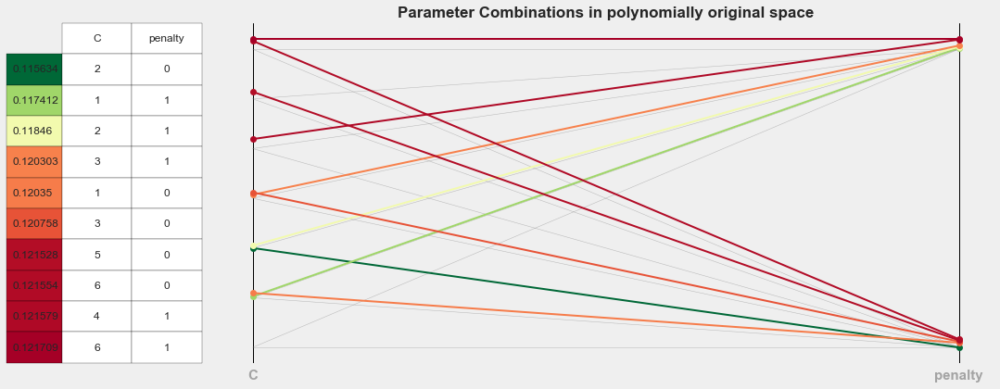

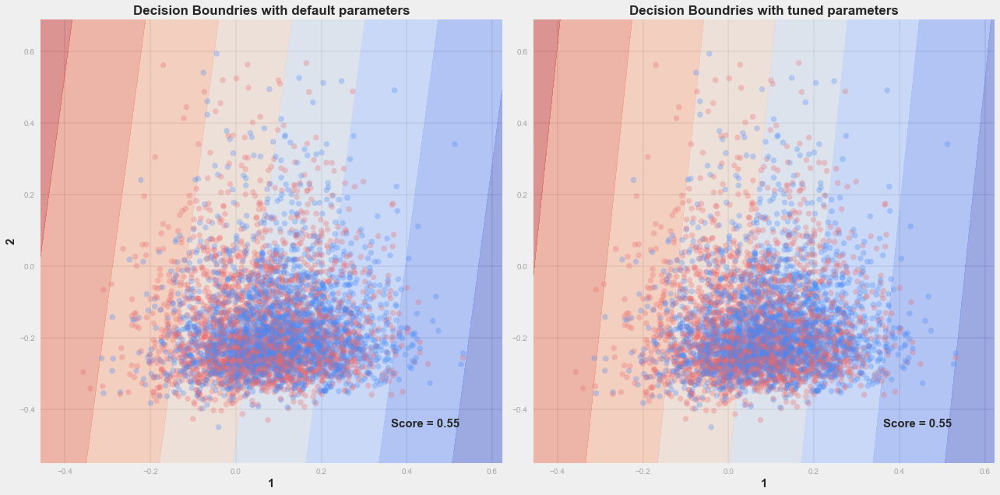

In [13]:
v1 = visuallize_tuning(grouped, 0, 'polynomially original')

stats = df_perf_lr[df_perf_lr['spa']==0].loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias\t:%.3f\nvar\t:%.6f\nloss\t:%.6f' % 
      (clf_name[1], 'polynomially original', stats[0], stats[1], stats[2]))

param_lr_ori = {'C':params['C'][2], 'penalty':params['penalty'][0]}.copy()
v2 = visuallize_decision_boundary(lr, X_train_polyspace[0][:5000], y_train[:5000], param_lr_ori, [1,2])
vis.plt.show()

Telling from different expected loss under different parameter setting, either L1 or L2 regularization can yield relatively good result but the regularization coefficient should be better set around 1 or 0.1. Too large or small values of C will increase the expected loss.

However, comparing with the baseline performance, tuning the parameters doesn't substantially improve the performance. When checking the decision boundaries drawn by the classifier. Compared with the model before tuning, the tuned model is more or less the same.

### b. PCA feature space:


The performance evaluation of Logistic Regression with polynomially PCA features are
bias	:0.341
var	:0.000008
loss	:0.116062


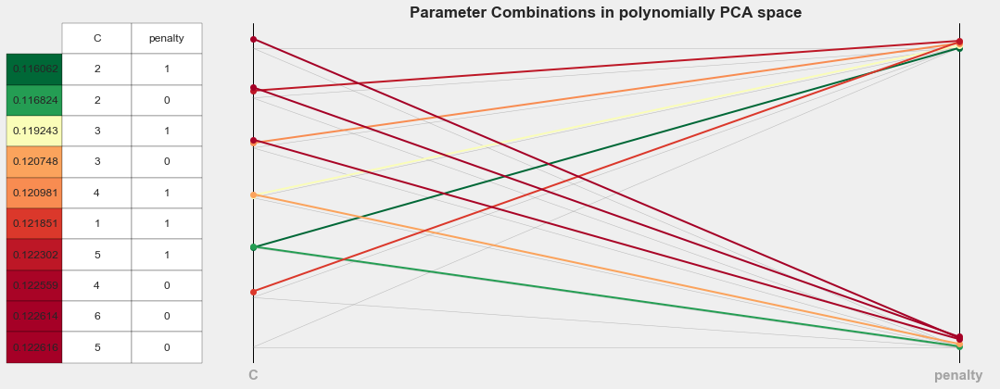

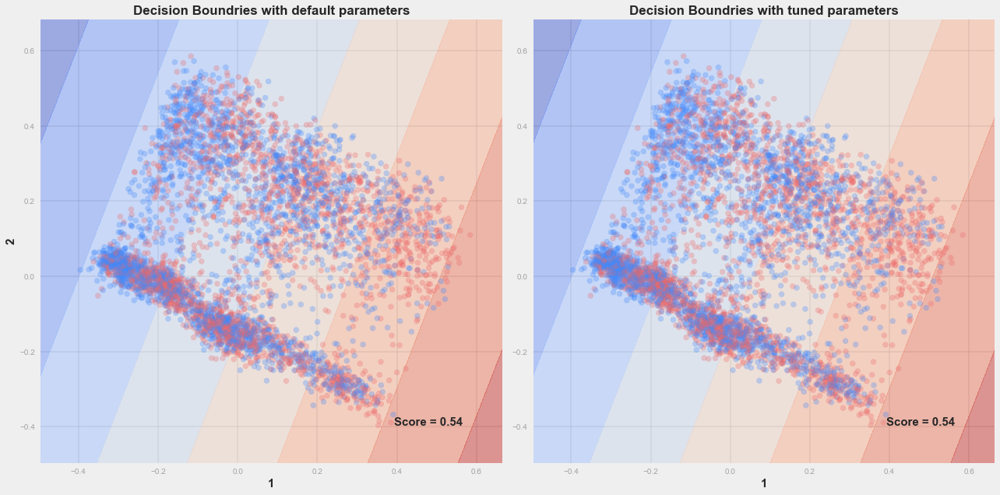

In [14]:
v1 = visuallize_tuning(grouped, 1, 'polynomially PCA')

stats = df_perf_lr[df_perf_lr['spa']==1].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias\t:%.3f\nvar\t:%.6f\nloss\t:%.6f' % 
      (clf_name[1], 'polynomially PCA', stats[0], stats[1], stats[2]))

param_lr_pca = {'C':params['C'][2], 'penalty':params['penalty'][1]}.copy()
v2 = visuallize_decision_boundary(lr, X_train_polyspace[1][:5000], y_train[:5000], param_lr_pca, [1,2])

vis.plt.show()

The situation is similar in PCA feature space. The performance didn't improve substantially. Although in PCA space, the regularization efficient is larger in general.

### c. SPCA feature space:


The performance evaluation of Logistic Regression with polynomially SPCA features are
bias:0.353
var:0.000040
expected loss:0.124780


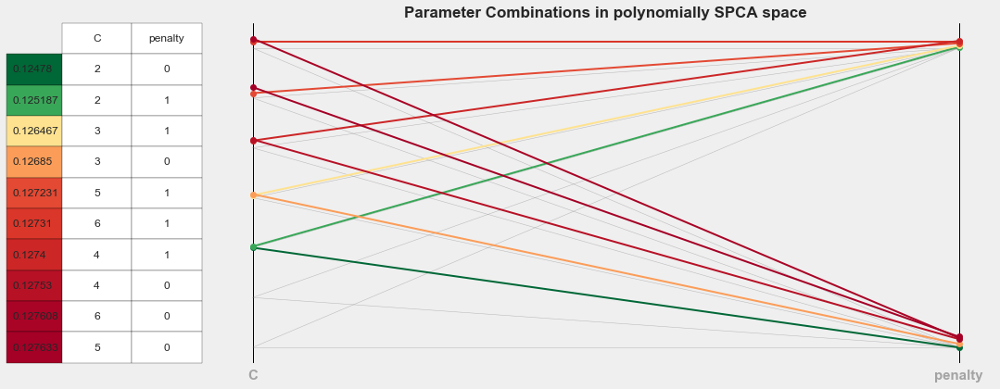

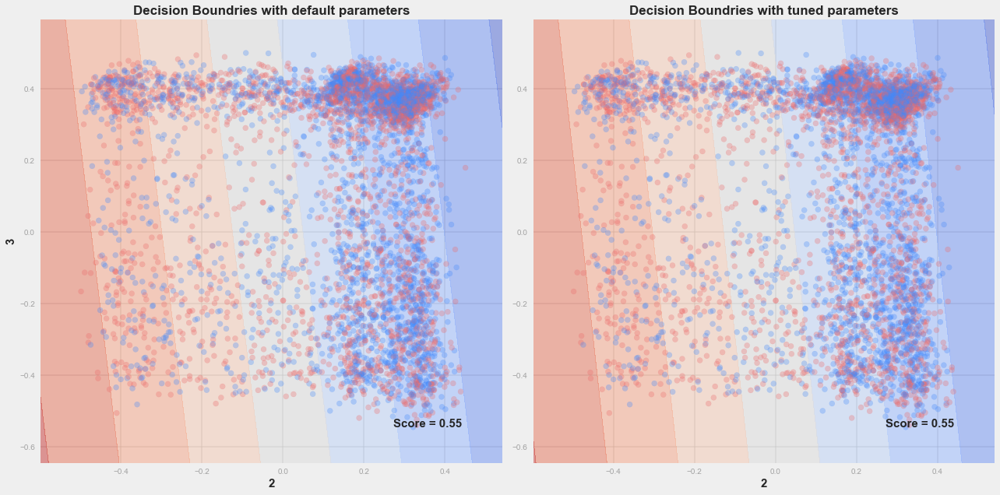

In [15]:
v1 = visuallize_tuning(grouped, 2, 'polynomially SPCA')

stats = df_perf_lr[df_perf_lr['spa']==2].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[1], 'polynomially SPCA', stats[0], stats[1], stats[2]))

param_lr_spca = {'C':params['C'][2], 'penalty':params['penalty'][0]}.copy()
v2 = visuallize_decision_boundary(lr, X_train_polyspace[2][:5000], y_train[:5000], param_lr_spca, [2,3])
vis.plt.show()

### d. factor analysis feature space:


The performance evaluation of Logistic Regression with polynomially FA features are
bias:0.351
var:0.000023
expected loss:0.123016


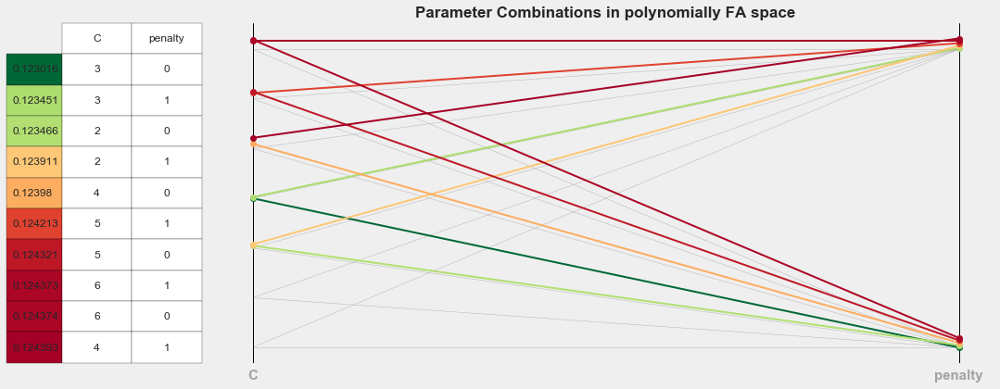

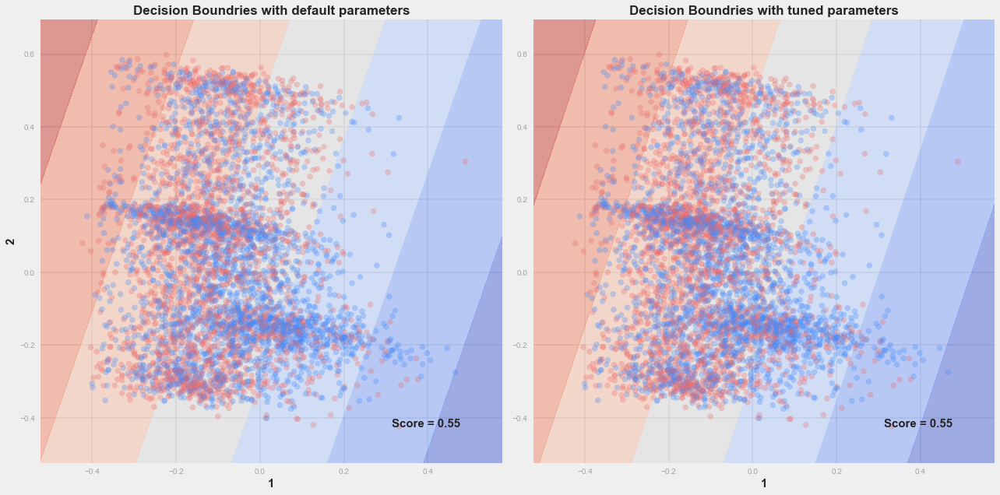

In [16]:
v1 = visuallize_tuning(grouped, 3, 'polynomially FA')

stats = df_perf_lr[df_perf_lr['spa']==3].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[1], 'polynomially FA', stats[0], stats[1], stats[2]))

param_lr_fa = {'C':params['C'][3], 'penalty':params['penalty'][0]}.copy()
v2 = visuallize_decision_boundary(lr, X_train_polyspace[3][:5000], y_train[:5000], param_lr_fa, [1,2])
vis.plt.show()

In factor analysis feature space, the data set requires even higher regularization coefficiency.

### e. NMF feature space:


The performance evaluation of Logistic Regression with polynomially NMF features are
bias:0.369
var:0.000020
expected loss:0.136317


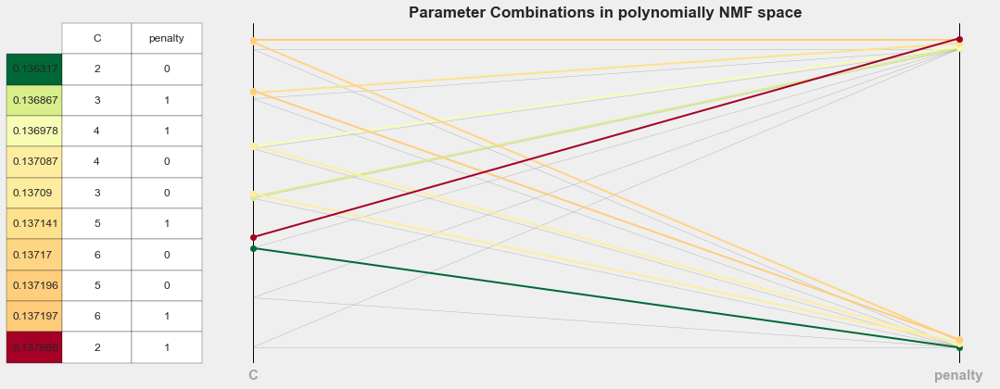

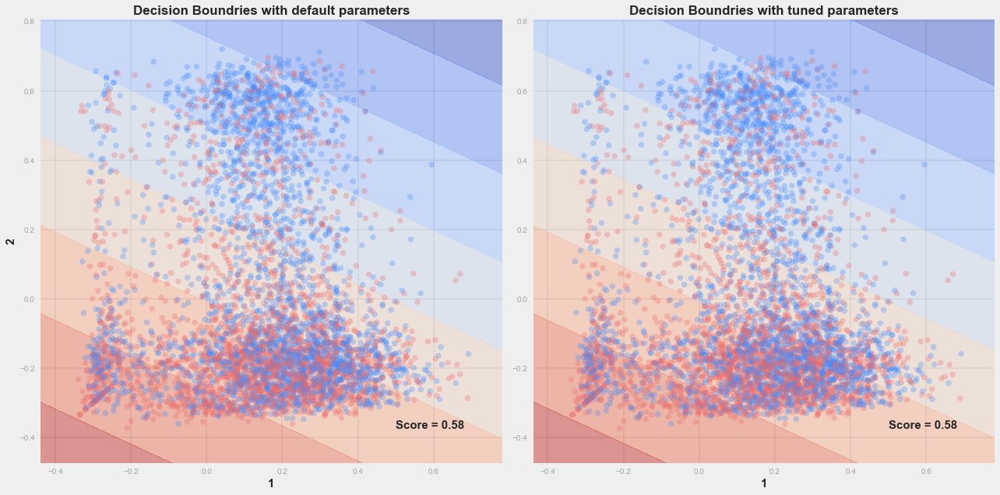

In [17]:
v1 = visuallize_tuning(grouped, 4, 'polynomially NMF')

stats = df_perf_lr[df_perf_lr['spa']==4].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[1], 'polynomially NMF', stats[0], stats[1], stats[2]))

param_lr_nmf = {'C':params['C'][2], 'penalty':params['penalty'][0]}.copy()
v2 = visuallize_decision_boundary(lr, X_train_polyspace[4][:5000], y_train[:5000], param_lr_nmf, [1,2])
vis.plt.show()

In general, a linear classifier like logistic regression is not capable to achieve high accuracy even if we map the features into quadratic polynomial space. If we map them into higher dimensional space, the computation becomes expensive. This leads us to the support vector machine which deals with higher dimensional space more efficiently using kernel trick.

# 3. SVM:

The main problem we have in previous 2 classifiers is about the features, they are not predictive enough. When we couldn't find more features, we can try to combine the existing ones in some mathmetical ways hoping to find some of them separating the classes well. And SVM helps us do this with kernel trick.

### Baseline performance with default setting:
We can see with default setting: {'kernel':'rbf', 'C':1.0, 'gamma':1/n_features}, the expected loss is higher than logistic regression.

In [18]:
bias, var, loss = evaluate_performance(svc, {}, kf_5, X_train_space[0], y_train, clf_name[2], 'original')


The performance evaluation of SVM with original features are
bias:0.358
var:0.000014
expected loss:0.128205


## Tune model in different feature space:

Grid search is performed on parameters:
    
    1. kernel type: ['poly'(degree=3), 'rbf']
    2. Error penalty(C): [1.0, 1.5, 2.0, 2.5, 3.5]
    3. Kernel coefficient(gamma): [-3.0, -2.0, -1.5, -1.0]

In [19]:
params = {'kernel':['poly', 'rbf'],
          'C':(10**1, 10**1.5, 10**2.0, 10**2.5, 10**3.5), 
          'gamma':(10**-3.0, 10**-2.0, 10**-1.5, 10**-1.0)}
"""
df_perf_svc = tune_model(svc, params, X_train_space, y_train)
df_perf_svc.to_csv('perfs_svc.csv', index=False)
"""

df_perf_svc = pd.read_csv('data/performances/perfs_svc.csv')
svc_vis = df_perf_svc.drop(['bias', 'var'], axis=1)
grouped = svc_vis.groupby('spa')

## Evaluate model performance in different feature spaces:

### a. original feature space:

Plotting out the best 10 parameter combinations:
Most of them use rbf as kernel, but the best ones use polynomial kernel;
polynomial kernel go with either small or large regularization efficiency but rbf kernel only accepts smaller ones;
The kernel coefficiency in general should be larger which gives it higher flexibility and less smooth decision boundaries. 


The performance evaluation of SVM with original features are
bias:0.342
var:0.000030
expected loss:0.116665


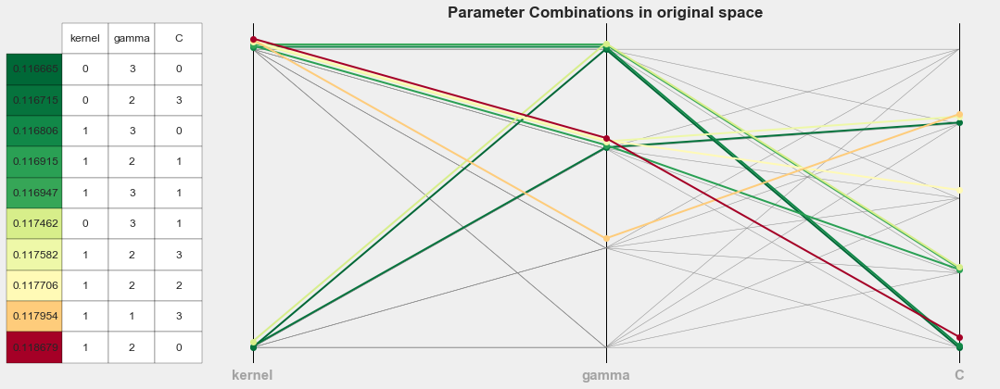

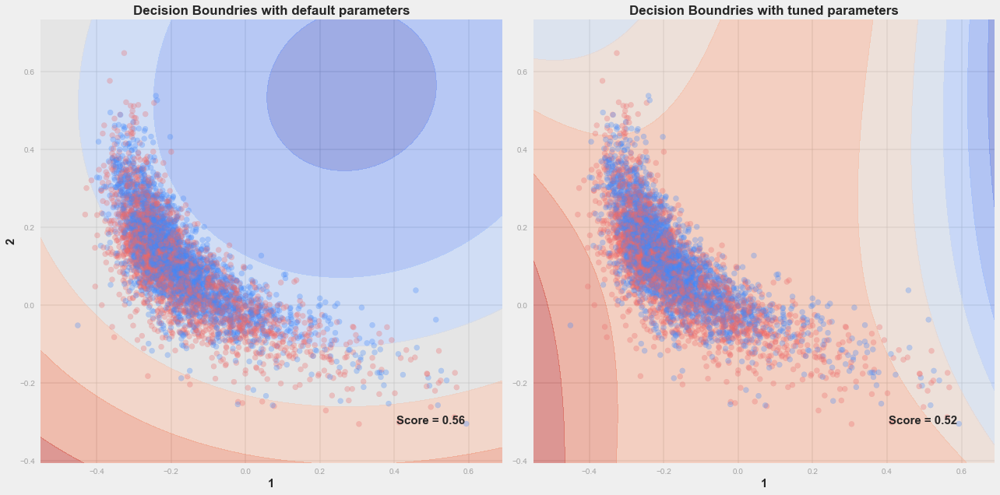

In [20]:
v1 = visuallize_tuning(grouped, 0, 'original')

stats = df_perf_svc[df_perf_svc['spa']==0].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[2], 'original', stats[0], stats[1], stats[2]))

param_svm_ori = {'kernel':params['kernel'][0], 'C':params['C'][0], 'gamma':params['gamma'][3]}.copy()
v2 = visuallize_decision_boundary(svc, X_train_space[0][:5000], y_train[:5000], param_svm_ori, [1,2])
vis.plt.show()

By comapring the tuned model and original model, the expected loss are smaller, that ensures the improvement. 

But the decision boundaries renders this improvement useless because at least with these 2 features, it classify most of the data points as unpopular. We will examine the ratio of positive and negative predictions in model selection section.

### b. PCA feature space:

In pca space, the svm classifier acts totally differnt. Most of the parameter combiantion favors the rbf kernel, and the regularization coefficiency seems irrelevant this time.


The performance evaluation of SVM with PCA features are
bias:0.343
var:0.000008
expected loss:0.117404


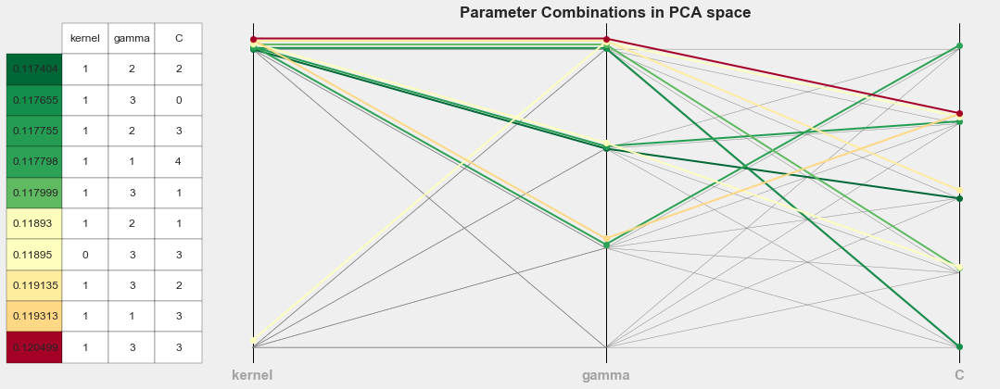

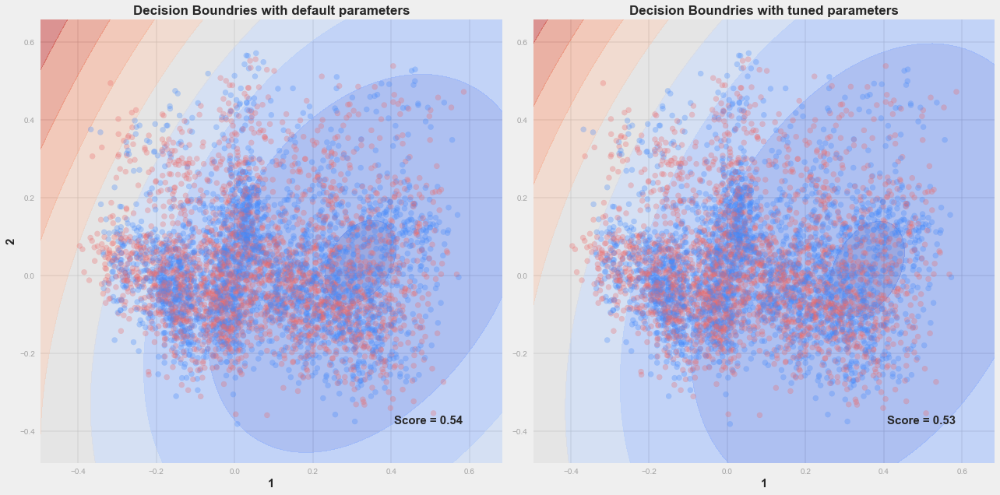

In [21]:
v1 = visuallize_tuning(grouped, 1, 'PCA')

stats = df_perf_svc[df_perf_svc['spa']==1].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[2], 'PCA', stats[0], stats[1], stats[2]))

param_svm_pca = {'kernel':params['kernel'][1], 'gamma':params['gamma'][2], 'C':params['C'][2]}.copy()
v2 = visuallize_decision_boundary(svc, X_train_space[1][:5000], y_train[:5000], param_svm_pca, [1,2])
vis.plt.show()

### c. SPCA feature space:


The performance evaluation of SVM with SPCA features are
bias:0.354
var:0.000028
expected loss:0.125003


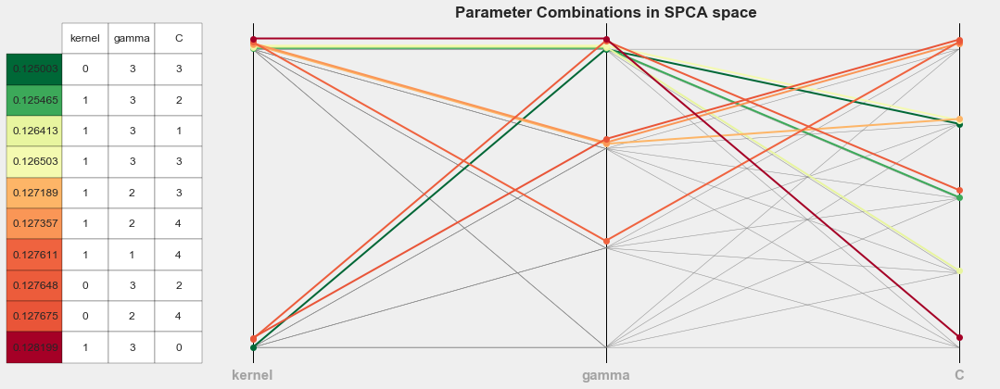

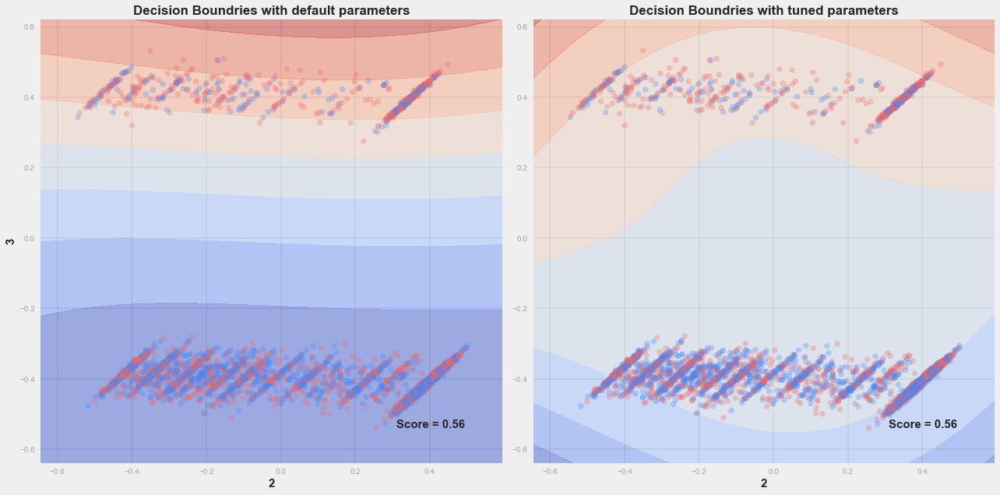

In [22]:
v1 = visuallize_tuning(grouped, 2, 'SPCA')

stats = df_perf_svc[df_perf_svc['spa']==2].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[2], 'SPCA', stats[0], stats[1], stats[2]))

param_svm_spca = {'kernel':params['kernel'][0], 'gamma':params['gamma'][3], 'C':params['C'][3]}.copy()
v2 = visuallize_decision_boundary(svc, X_train_space[2][:5000], y_train[:5000], param_svm_spca, [2,3])
vis.plt.show()

In sparse PCA space, the expected loss are higher than previous that of previous 2 feature sets. The best parameter combinations are similar to those in original spaces. And we can see in the decision boundary plotting that the classifier become less confident after tuning.

### d. factor analysis feature space:

Again, the classifier in this space labeled everything as popular thus could be meaningless.


The performance evaluation of SVM with FA features are
bias:0.349
var:0.000020
expected loss:0.122080


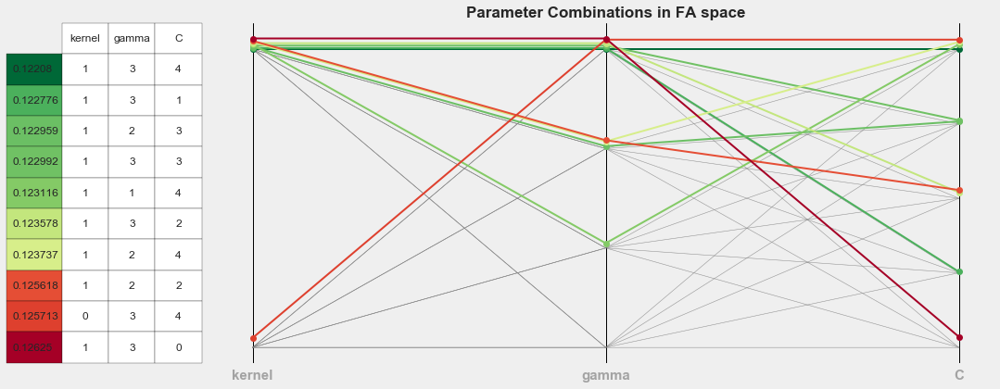

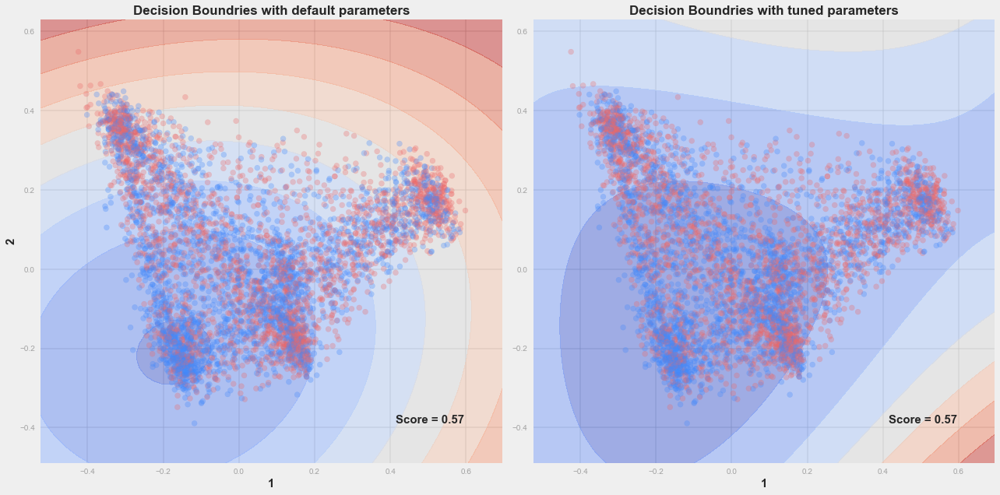

In [23]:
v1 = visuallize_tuning(grouped, 3, 'FA')

stats = df_perf_svc[df_perf_svc['spa']==3].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[2], 'FA', stats[0], stats[1], stats[2]))

param_svm_fa = {'kernel':params['kernel'][1], 'gamma':params['gamma'][3], 'C':params['C'][4]}.copy()
v2 = visuallize_decision_boundary(svc, X_train_space[3][:5000], y_train[:5000], param_svm_fa, [1,2])
vis.plt.show()

### e. NMF feature space:


The performance evaluation of SVM with NMF features are
bias:0.365
var:0.000011
expected loss:0.133344


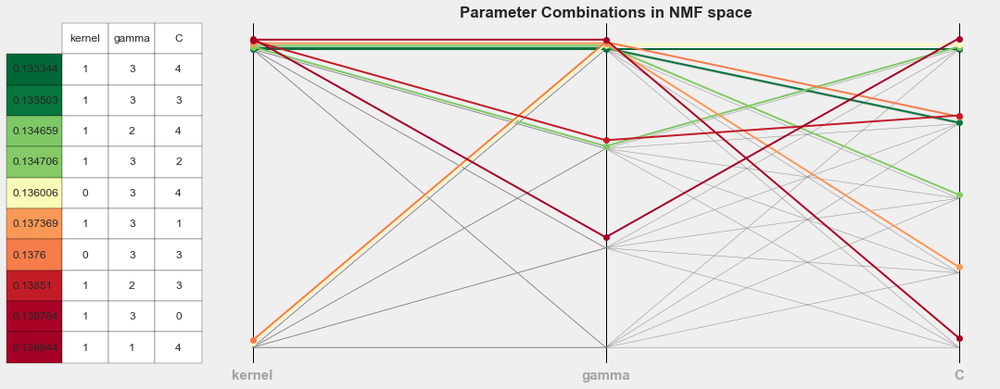

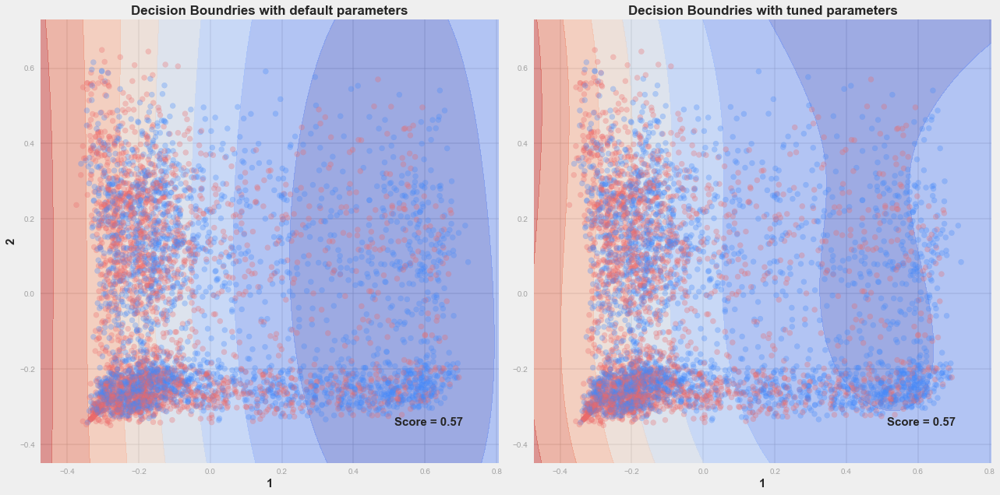

In [24]:
v1 = visuallize_tuning(grouped, 4, 'NMF')

stats = df_perf_svc[df_perf_svc['spa']==4].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[2], 'NMF', stats[0], stats[1], stats[2]))

param_svm_nmf = {'kernel':params['kernel'][1], 'gamma':params['gamma'][3], 'C':params['C'][4]}.copy()
v2 = visuallize_decision_boundary(svc, X_train_space[4][:5000], y_train[:5000], param_svm_nmf, [1,2])
vis.plt.show()

# 4. k-Nearest Neighbor:

So far we have tested 3 classifiers, and the best one is SVM and logistic regression. But still, we hope to find models that predict better. What is in common about those 3 classifiers is that they are all feature-based. In other words, we have been manipulating features in different ways to make prediction. Maybe there is a limitation of this method on our data set. So this time, we will try KNN which is instance-based, so that every prediction will be made by surrounding data points whose labels are already known. And this model has a very high representability. 

### Baseline performance with default setting:

When we put original data directly into KNN classifier with default parameter setting: {'n_neighbors':5, 'weights':'uniform', 'metric':'minkowski'}, the baseline expected loss is 0.15.

In [25]:
bias, var, loss = evaluate_performance(knn, {}, kf_5, X_train_space[0], y_train, clf_name[3], 'original')


The performance evaluation of k-Nearest Neighbours with original features are
bias:0.394
var:0.000030
expected loss:0.155499


## Tune model in different feature space:

Grid search is performed on parameters:
    
    1. Number of neighbors: [20, 40, 80, 160]
    2. Weighting methods: ['uniform', 'distance']
    3. Distance metric: ['manhattan', 'euclidean', 'minkowski']

In [26]:
params = {'n_neighbors':[20, 40, 80, 160],
          'weights':['uniform', 'distance'],
          'metric':['manhattan', 'euclidean', 'minkowski']}
"""
df_perf_knn = tune_model(knn, params, X_train_space, y_train)
df_perf_knn.to_csv('data/performances/perfs_knn.csv', index=False)
"""

df_perf_knn = pd.read_csv('data/performances/perfs_knn.csv')
knn_vis = df_perf_knn.drop(['bias', 'var'], axis=1)
knn_vis.columns=['wgt', 'n_ngb', 'mtr', 'spa', 'loss']
grouped = knn_vis.groupby('spa')

## Evaluate model performance in different feature spaces:

### a. original feature space:


The performance evaluation of k-Nearest Neighbours with original features are
bias:0.362
var:0.000012
expected loss:0.131136


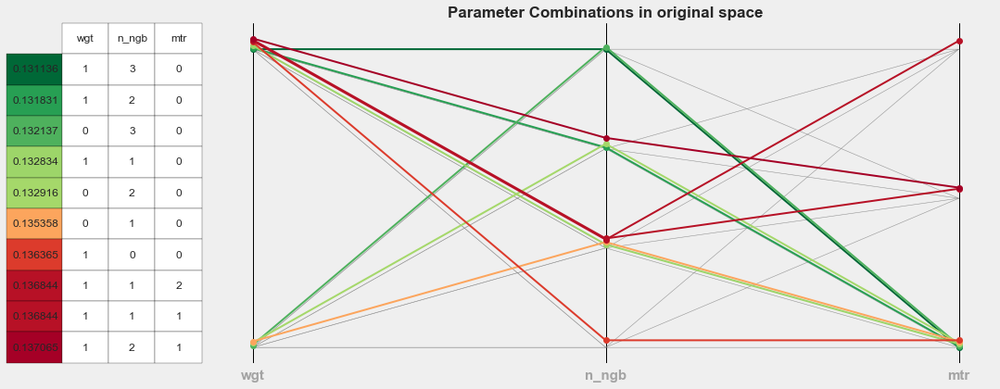

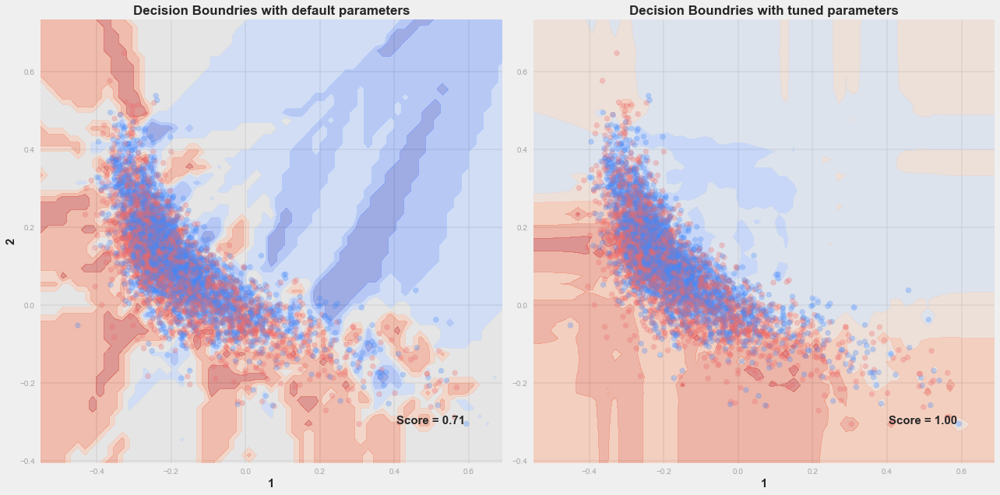

In [27]:
v1 = visuallize_tuning(grouped, 0, 'original')

stats = df_perf_knn[df_perf_knn['spa']==0].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[3], 'original', stats[0], stats[1], stats[2]))

param_knn_ori = {'weights':params['weights'][1], 'n_neighbors':params['n_neighbors'][3], 
                 'metric':params['metric'][0]}.copy()
v2 = visuallize_decision_boundary(knn, X_train_space[0][:5000], y_train[:5000], param_knn_ori, [1,2])
vis.plt.show()

In general, the knn classifier prefers distance weighting, which assigns smaller weight to data pointer further away, and manhattan distance metric. Also it gives us better result when we allow it to consider more neighbors each time. This matchs the decision boundaries because we can see they are much smoother after tuning which may be the reason why the expected loss is higher than previous 2 classifiers. Maybe the representability of knn is too much more than what we need thus doesn't generalize will.

### b. PCA feature space:


The performance evaluation of k-Nearest Neighbours with PCA features are
bias:0.369
var:0.000015
expected loss:0.136231


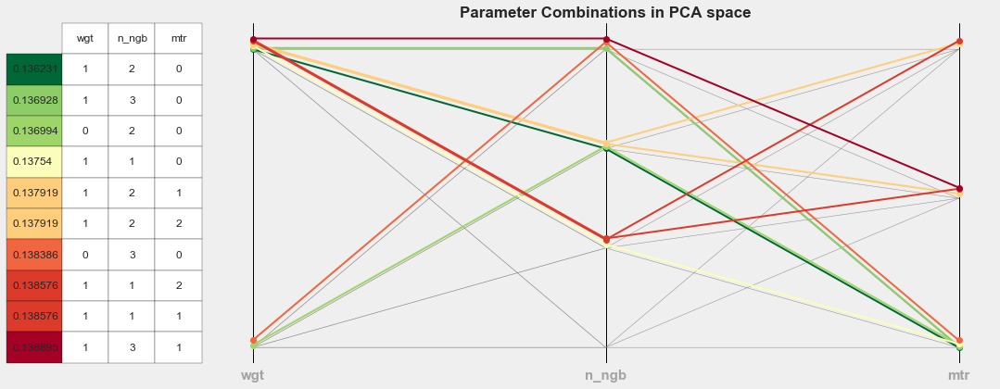

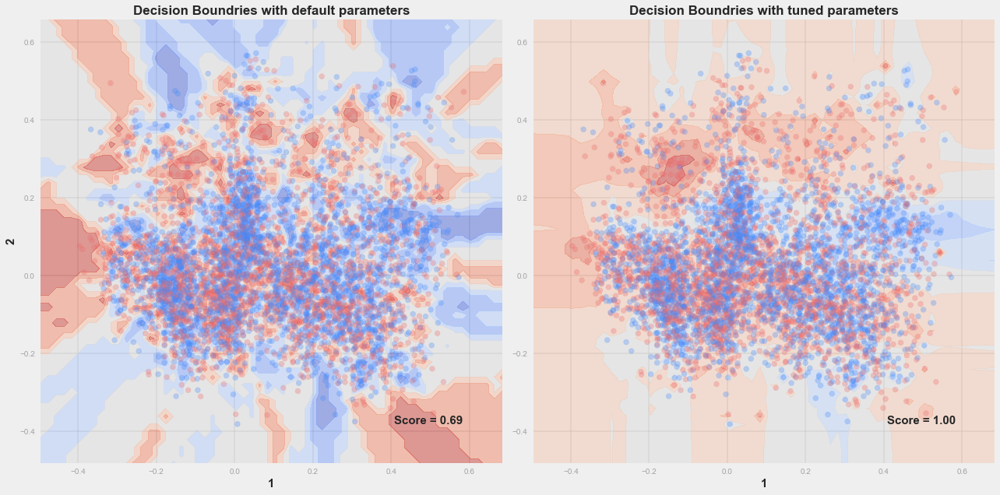

In [28]:
v1 = visuallize_tuning(grouped, 1, 'PCA')

stats = df_perf_knn[df_perf_knn['spa']==1].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[3], 'PCA', stats[0], stats[1], stats[2]))

param_knn_pca = {'weights':params['weights'][1], 'n_neighbors':params['n_neighbors'][2], 
                 'metric':params['metric'][0]}.copy()
v2 = visuallize_decision_boundary(knn, X_train_space[1][:5000], y_train[:5000], param_knn_pca, [1,2])
vis.plt.show()

### c. SPCA feature space:


The performance evaluation of k-Nearest Neighbours with SPCA features are
bias:0.368
var:0.000004
expected loss:0.135346


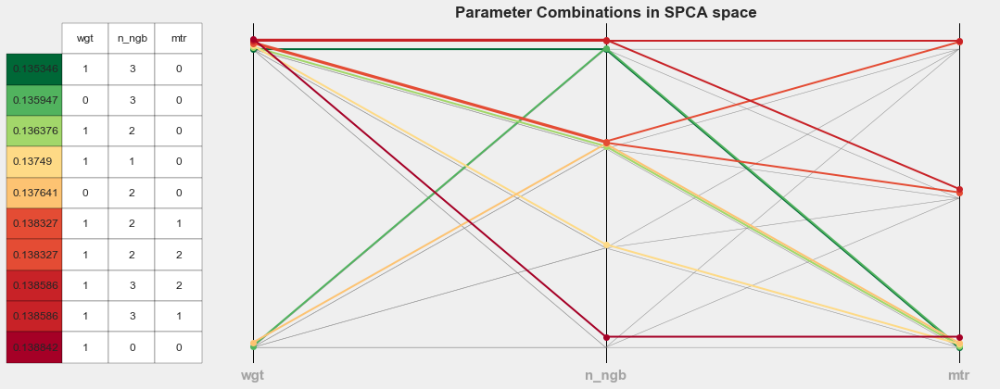

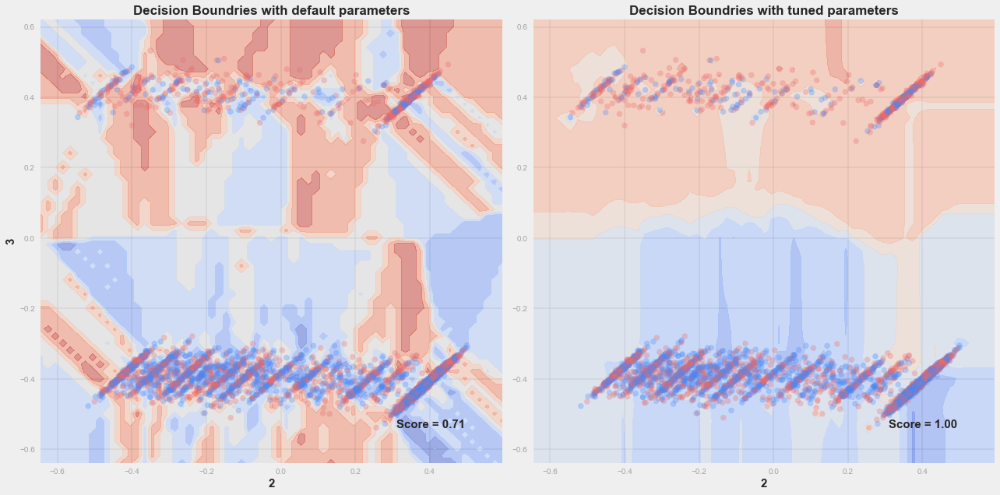

In [29]:
v1 = visuallize_tuning(grouped, 2, 'SPCA')

stats = df_perf_knn[df_perf_knn['spa']==2].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[3], 'SPCA', stats[0], stats[1], stats[2]))

param_knn_spca = {'weights':params['weights'][1], 'n_neighbors':params['n_neighbors'][3], 'metric':params['metric'][0]}.copy()
v2 = visuallize_decision_boundary(knn, X_train_space[2][:5000], y_train[:5000], param_knn_spca, [2,3])
vis.plt.show()

### d. factor analysis feature space:


The performance evaluation of k-Nearest Neighbours with FA features are
bias:0.373
var:0.000017
expected loss:0.138815


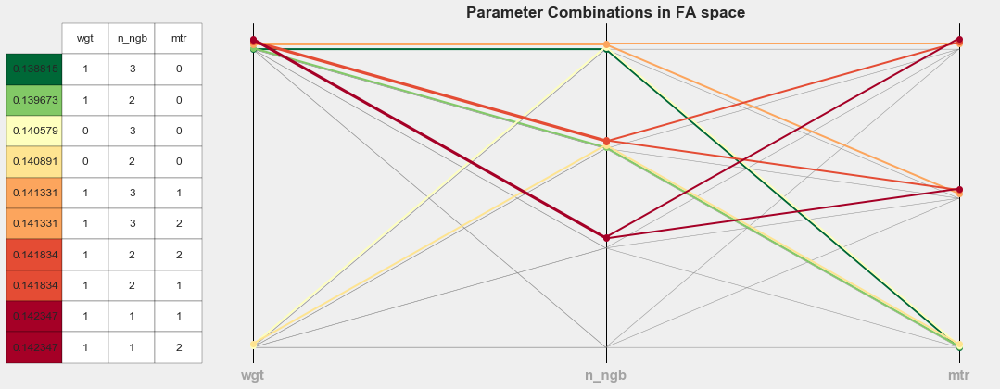

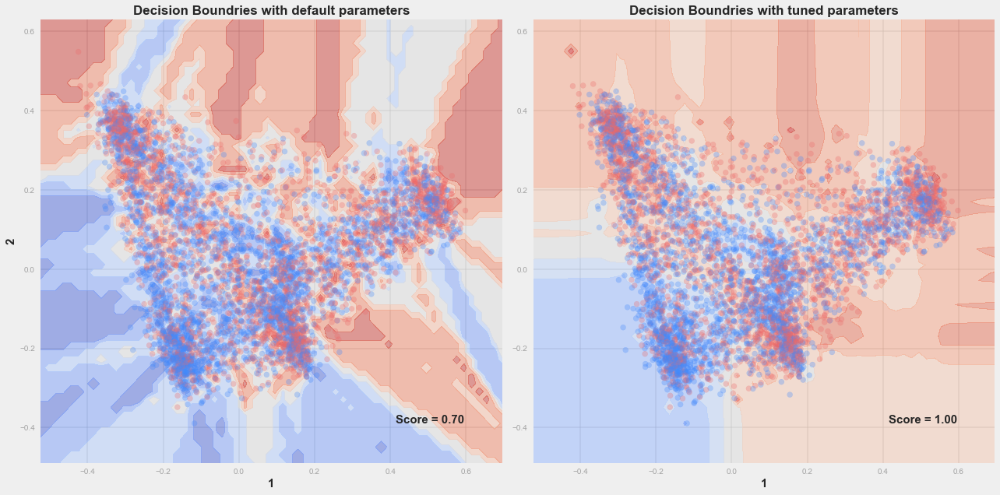

In [30]:
v1 = visuallize_tuning(grouped, 3, 'FA')

stats = df_perf_knn[df_perf_knn['spa']==3].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[3], 'FA', stats[0], stats[1], stats[2]))

param_knn_fa = {'weights':params['weights'][1], 'n_neighbors':params['n_neighbors'][3], 'metric':params['metric'][0]}.copy()
v2 = visuallize_decision_boundary(knn, X_train_space[3][:5000], y_train[:5000], param_knn_fa, [1,2])
vis.plt.show()

### e. NMF feature space:


The performance evaluation of k-Nearest Neighbours with NMF features are
bias:0.376
var:0.000016
expected loss:0.141531


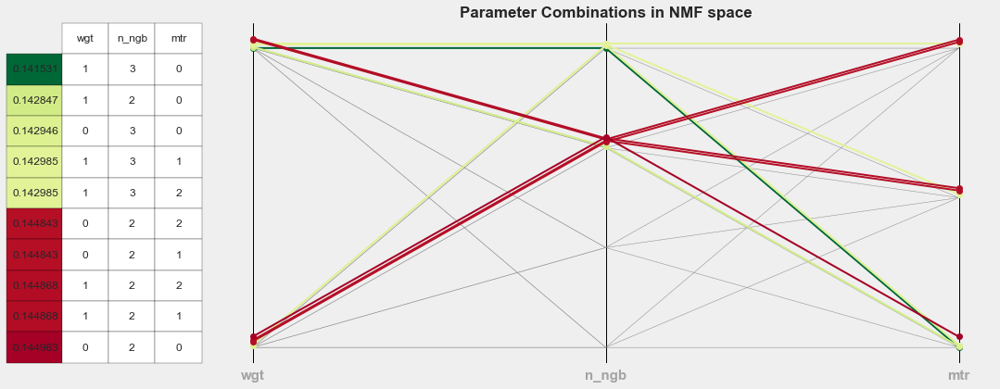

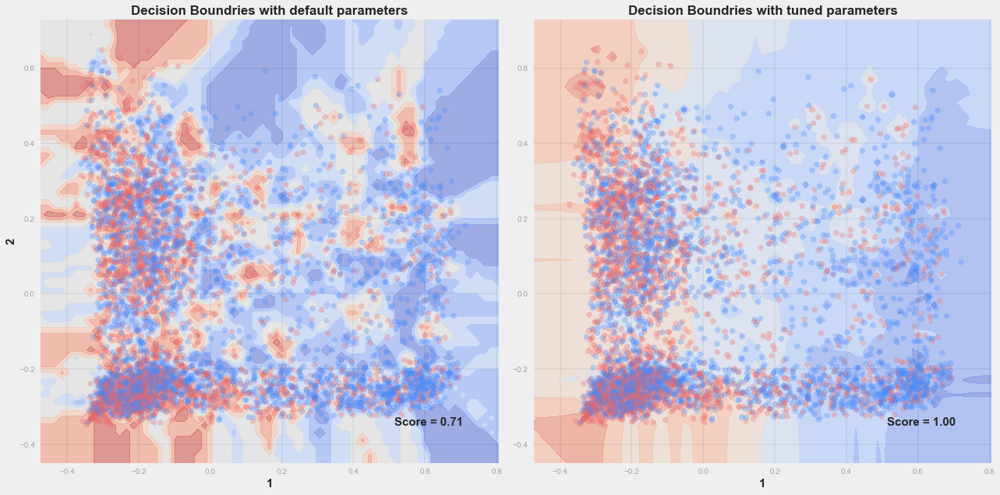

In [31]:
v1 = visuallize_tuning(grouped, 4, 'NMF')

stats = df_perf_knn[df_perf_knn['spa']==4].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[3], 'NMF', stats[0], stats[1], stats[2]))

param_knn_nmf = {'weights':params['weights'][1], 'n_neighbors':params['n_neighbors'][3], 
                 'metric':params['metric'][0]}.copy()
v2 = visuallize_decision_boundary(knn, X_train_space[4][:5000], y_train[:5000], param_knn_nmf, [1,2])
vis.plt.show()

In general, the KNN classifier gives a median performance. Its flexibility isn't of much use here.

If both feature-based classifiers and instance-based classifiers can't generalize the data set well, we have to try ensemble method which combines the decision of multiple classifiers. So the rest 2 classifiers we are testing, random forest and extra gradient boosting, are both tree based emsemble classifiers. The former one, random forest classifier simply combines decision by averaging the predictions of an assigned number of tree classifiers. And the latter one, extra gradient boosting, focus more on the data points which are difficult to classify.

# 5. Random Forest Classifier:

### Baseline performance with default setting:

By default, the random forest classifier from sklearn library uses 10 trees and keeps spliting until all nodes have data points in same class or the number of data points are equal to 2.

In [32]:
bias, var, loss = evaluate_performance(rf, {}, kf_5, X_train_space[0], y_train, clf_name[4], 'original')


The performance evaluation of Random Forest with original features are
bias:0.385
var:0.000015
expected loss:0.148468


### Tune model in different feature space:

Grid search is performed on parameters:
    
    1. Number of trees: [100, 200, 400, 800, 1600]
    2. Maximal depth of each tree: [10, 20, 30]
    3. Minimal leaf node sample size: [2, 5, 10, 20, 40]

So in this parameter tuning, we will try more trees to see whether that will improve the accuracy and control the complexity of trees by maximal depth and minimal sample size of leaf nodes.

In [33]:
params = {'n_estimators':(100, 200, 400, 800, 1600),
          'max_depth':(5, 10, 20, 30),
          'min_samples_split':(2, 5, 10, 20, 40),
          'n_jobs':[3]}
"""
df_perf_rf = tune_model(rf, params, X_train_space, y_train)
df_perf_rf.to_csv('data/performances/perfs_rf.csv', index=False)
"""

df_perf_rf = pd.read_csv('data/performances/perfs_rf.csv')
rf_vis = df_perf_rf.drop(['bias', 'var', 'n_jobs'], axis=1)
rf_vis.columns=['tree', 'leaf', 'depth', 'spa', 'loss']
grouped = rf_vis.groupby('spa')

## Evaluate model performance in different feature spaces:

### a. original feature space:


The performance evaluation of Random Forest with original features are
bias:0.340
var:0.000006
expected loss:0.115506


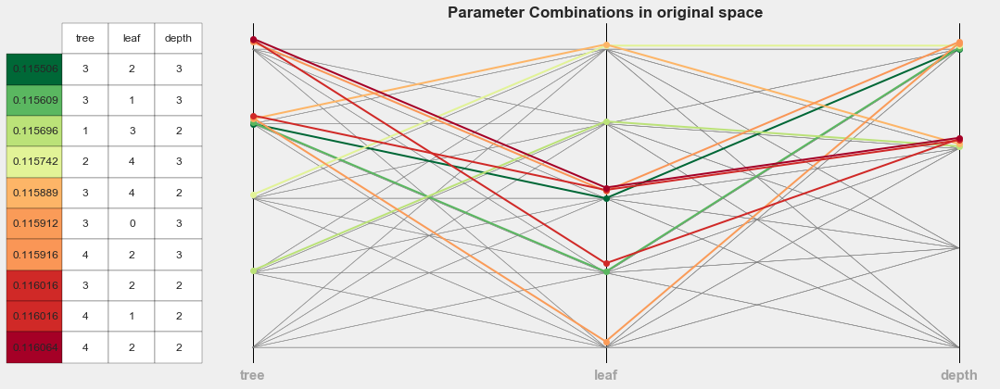

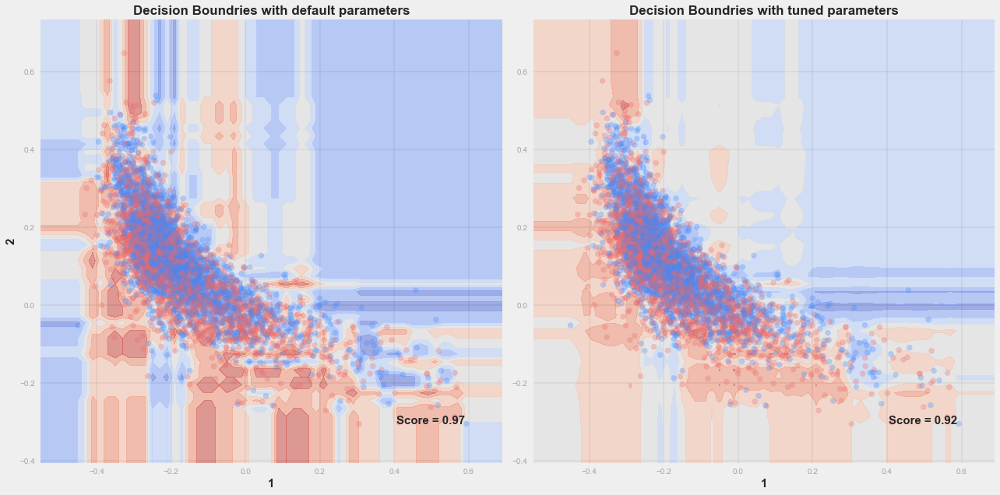

In [34]:
v1 = visuallize_tuning(grouped, 0, 'original')

stats = df_perf_rf[df_perf_rf['spa']==0].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[4], 'original', stats[0], stats[1], stats[2]))

param_rf_ori = {'n_estimators':params['n_estimators'][3], 'max_depth':params['max_depth'][3], 
         'min_samples_split':params['min_samples_split'][2]}.copy()
v2 = visuallize_decision_boundary(rf, X_train_space[0][:5000], y_train[:5000], param_rf_ori, [1,2])
vis.plt.show()

It seems like random forest classifier tend to use median level of trees, median level of leaf node size but high level of depth. So the tree has more flexibility to fit the data set. And the performance is reasonable.

Compared with default model, we have much more trees after tuning, but less representability. Because our smallest leaf node size allow is 10 data points now versus 2 before. Thus the decision boundaries are smoother.

### b. PCA feature space:

The situation is similar in PCA feature space. More trees and larger leaf node size, larger depth.


The performance evaluation of Random Forest with PCA features are
bias:0.344
var:0.000017
expected loss:0.118353


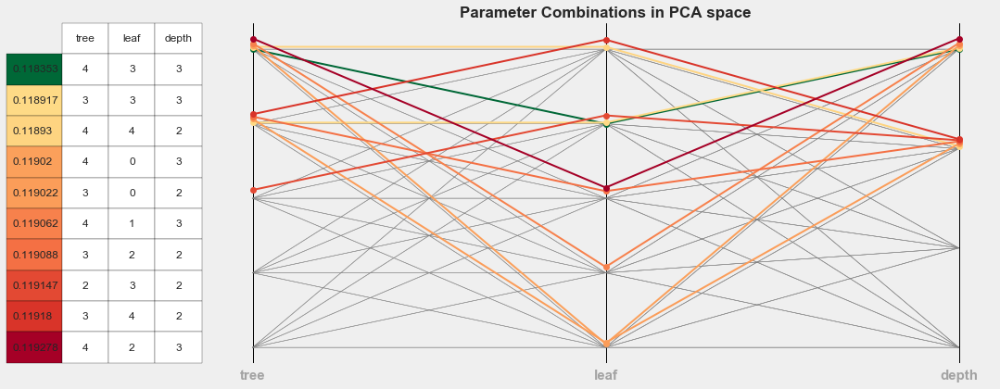

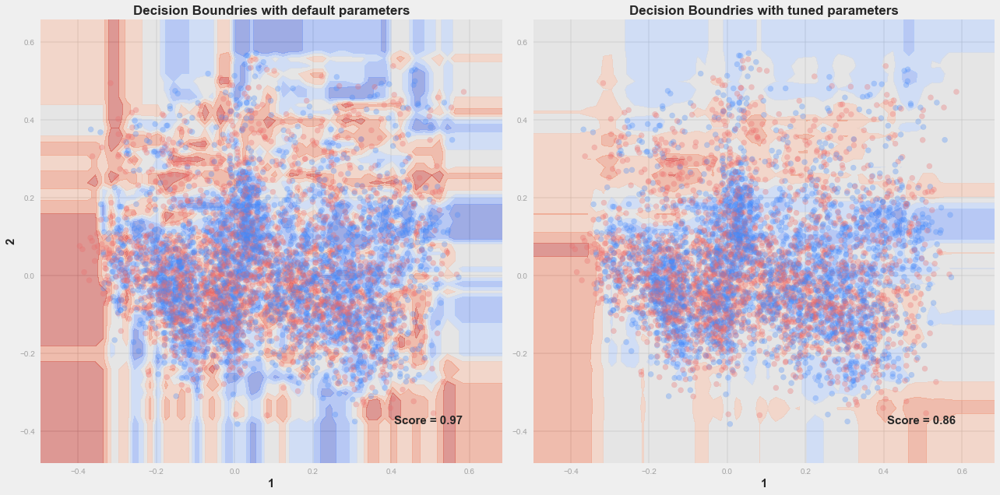

In [35]:
v1 = visuallize_tuning(grouped, 1, 'PCA')

stats = df_perf_rf[df_perf_rf['spa']==1].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[4], 'PCA', stats[0], stats[1], stats[2]))

param_rf_pca = {'n_estimators':params['n_estimators'][4], 'max_depth':params['max_depth'][3], 
         'min_samples_split':params['min_samples_split'][3]}.copy()
v2 = visuallize_decision_boundary(rf, X_train_space[1][:5000], y_train[:5000], param_rf_pca, [1,2])
vis.plt.show()

### c. SPCA feature space:


The performance evaluation of Random Forest with SPCA features are
bias:0.346
var:0.000021
expected loss:0.119789


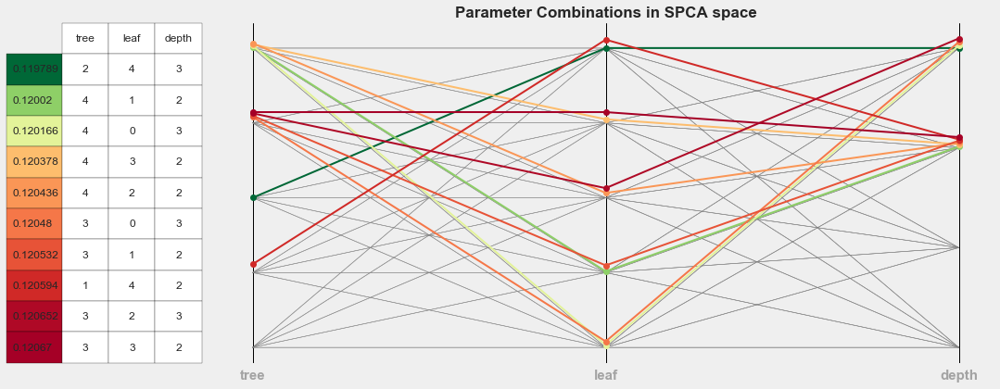

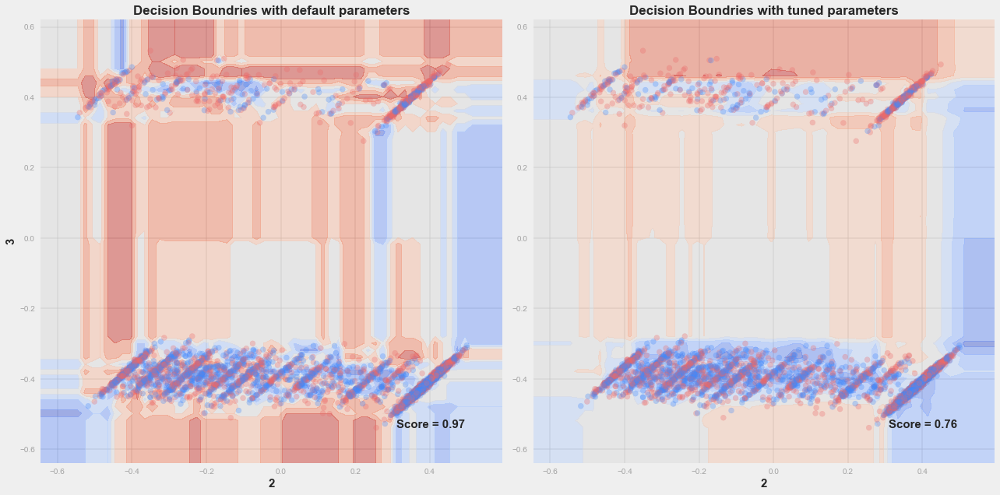

In [36]:
v1 = visuallize_tuning(grouped, 2, 'SPCA')

stats = df_perf_rf[df_perf_rf['spa']==2].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[4], 'SPCA', stats[0], stats[1], stats[2]))

param_rf_spca = {'n_estimators':params['n_estimators'][2], 'max_depth':params['max_depth'][3], 
         'min_samples_split':params['min_samples_split'][4]}.copy()
v2 = visuallize_decision_boundary(rf, X_train_space[2][:5000], y_train[:5000], param_rf_spca, [2,3])
vis.plt.show()

### d. factor analysis feature space:


The performance evaluation of Random Forest with FA features are
bias:0.352
var:0.000024
expected loss:0.123693


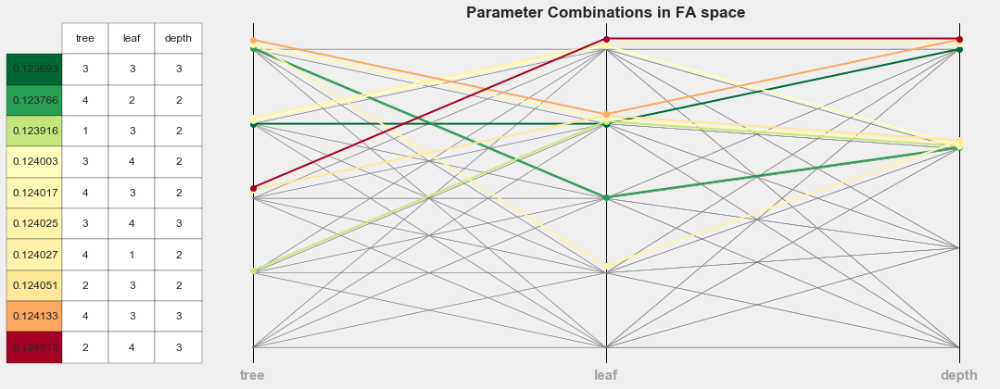

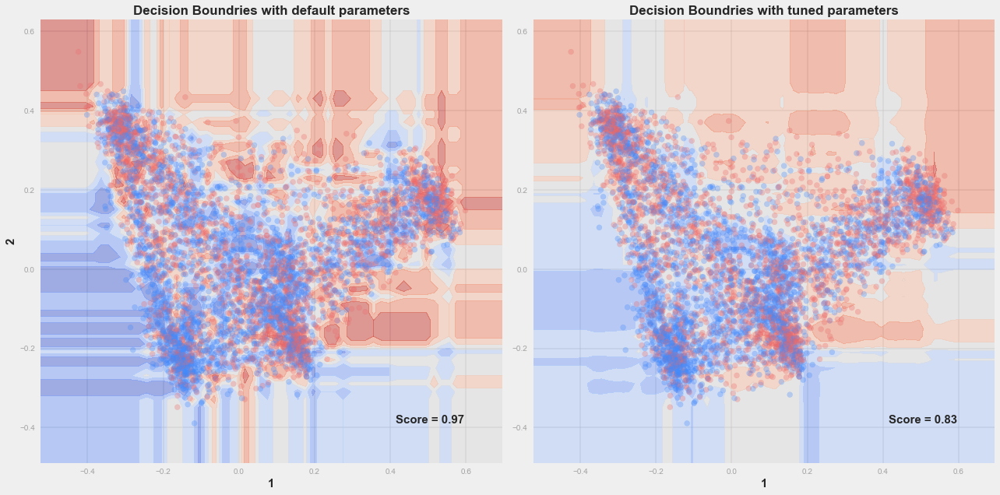

In [37]:
v1 = visuallize_tuning(grouped, 3, 'FA')

stats = df_perf_rf[df_perf_rf['spa']==3].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[4], 'FA', stats[0], stats[1], stats[2]))

param_rf_fa = {'n_estimators':params['n_estimators'][3], 'max_depth':params['max_depth'][3], 
         'min_samples_split':params['min_samples_split'][3]}.copy()
v2 = visuallize_decision_boundary(rf, X_train_space[3][:5000], y_train[:5000], param_rf_fa, [1,2])
vis.plt.show()

### e. NMF feature space:


The performance evaluation of Random Forest with NMF features are
bias:0.364
var:0.000032
expected loss:0.132555


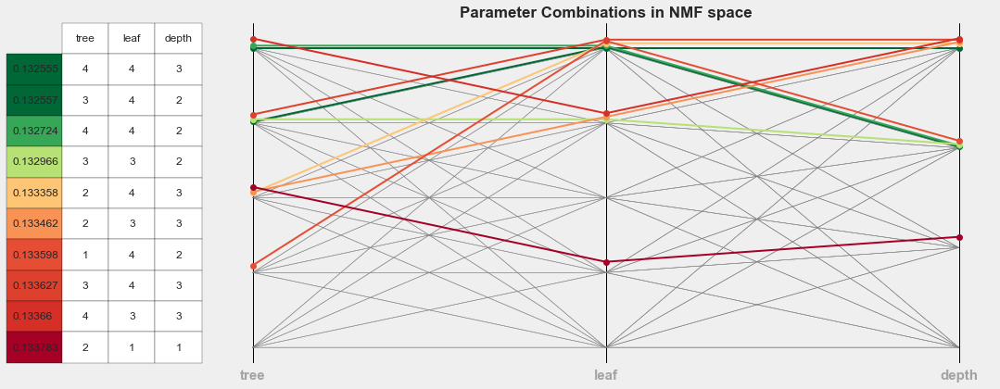

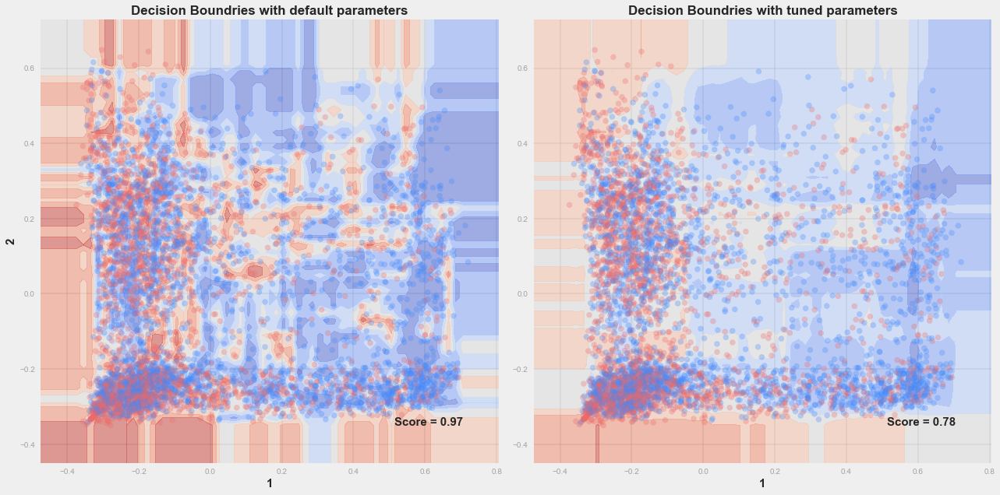

In [38]:
v1 = visuallize_tuning(grouped, 4, 'NMF')

stats = df_perf_rf[df_perf_rf['spa']==4].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[4], 'NMF', stats[0], stats[1], stats[2]))

param_rf_nmf = {'n_estimators':params['n_estimators'][4], 'max_depth':params['max_depth'][3], 
                'min_samples_split':params['min_samples_split'][4]}.copy()
v2 = visuallize_decision_boundary(rf, X_train_space[4][:5000], y_train[:5000], param_rf_nmf, [1,2])
vis.plt.show()

# 7. XGBoost:

The extra gradient boost is a popular emsemble model. By starting from simple classifiers, it keeps adding new tree classifiers based on the wrong predictions.

### Baseline performance with default setting:

When we input data directly into xgb with default parameter setting: {'subsample':1, 'gamma':0, 'reg_alpha':0}, the performance is already very good.

In [39]:
bias, var, loss = evaluate_performance(xgb, {}, kf_5, X_train_space[0], y_train, clf_name[5], 'original')


The performance evaluation of XGBoost with original features are
bias:0.339
var:0.000025
expected loss:0.115272


### Tune model in different feature space:

Grid search is performed on parameters:
    
    1. Subsample ratio of each time of fitting: [0.2, 0.5, 0.8, 1]
    2. Minimum loss reduction required to make a split(gamma): [0, 0.2, 0.5, 1]
    3. Coefficient of L1 regularization(alpha): [0.001, 0.01, 0.1, 1]

In [40]:
params = {'subsample':[0.2, 0.5, 0.8, 1],
          'gamma':[0, 0.2, 0.5, 1],
          'reg_alpha':[0.001, 0.01, 0.1, 1],
          'silent':[1],
          'nthread':[4],
          'objective':['binary:logistic']}
"""
df_perf_xgb = tune_model(xgb, params, X_train_space, y_train)
df_perf_xgb.to_csv('data/performances/perfs_xgb.csv', index=False)
"""

df_perf_xgb = pd.read_csv('data/performances/perfs_xgb.csv')
df_perf_xgb = df_perf_xgb.drop(['silent', 'nthread', 'objective'], axis=1)
xgb_vis = df_perf_xgb.drop(['bias', 'var'], axis=1)
xgb_vis.columns = ['gam', 'bag', 'reg', 'spa', 'loss']
grouped = xgb_vis.groupby('spa')

## Evaluate model performance in different feature spaces:

### a. original feature space:

Almost all the best combinations use 0.5 as the subsampling ratio. And as for regularization coefficiency, either highest one or lowest one are ok but not intermedian ones.


The performance evaluation of XGBoost with original features are
bias:0.337
var:0.000036
expected loss:0.113580


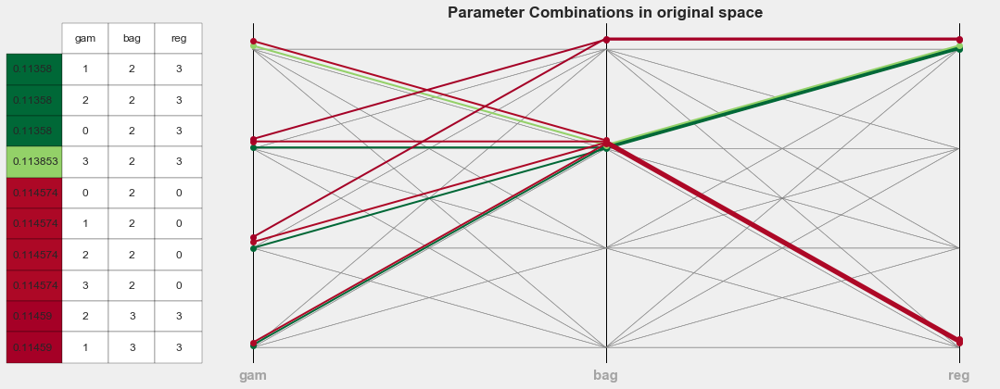

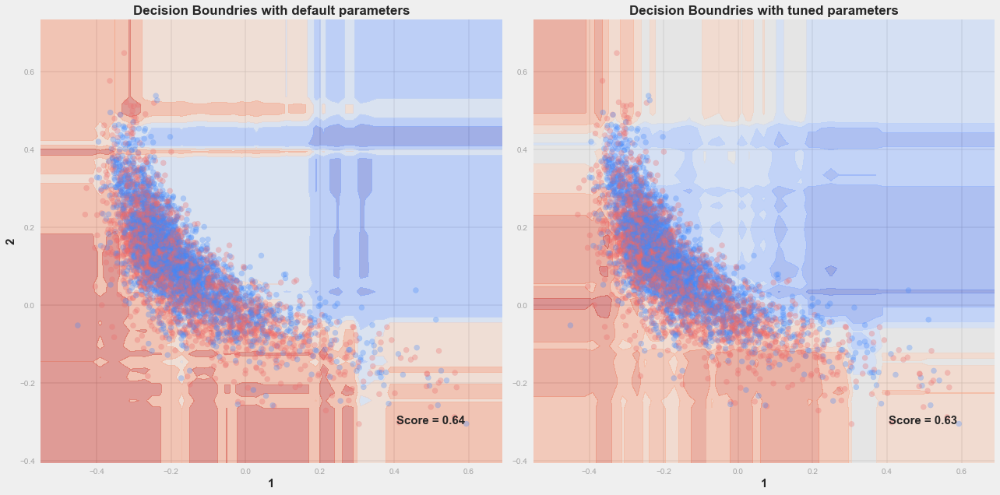

In [41]:
v1 = visuallize_tuning(grouped, 0, 'original')

stats = df_perf_xgb[df_perf_xgb['spa']==0].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[5], 'original', stats[0], stats[1], stats[2]))

param_xgb_ori = {'gamma':params['gamma'][1], 'subsample':params['subsample'][2], 
                 'reg_alpha':params['reg_alpha'][3]}.copy()
v2 = visuallize_decision_boundary(xgb, X_train_space[0][:5000], y_train[:5000], param_xgb_ori, [1,2])
vis.plt.show()

### b. PCA feature space:


The performance evaluation of XGBoost with PCA features are
bias:0.347
var:0.000046
expected loss:0.120789


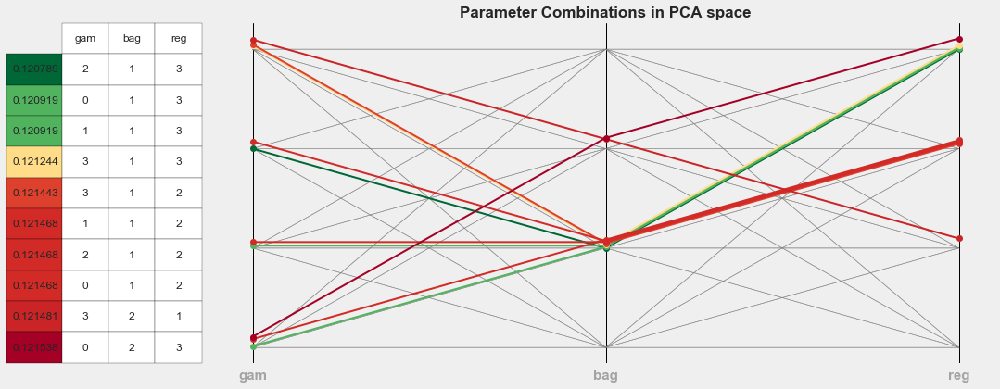

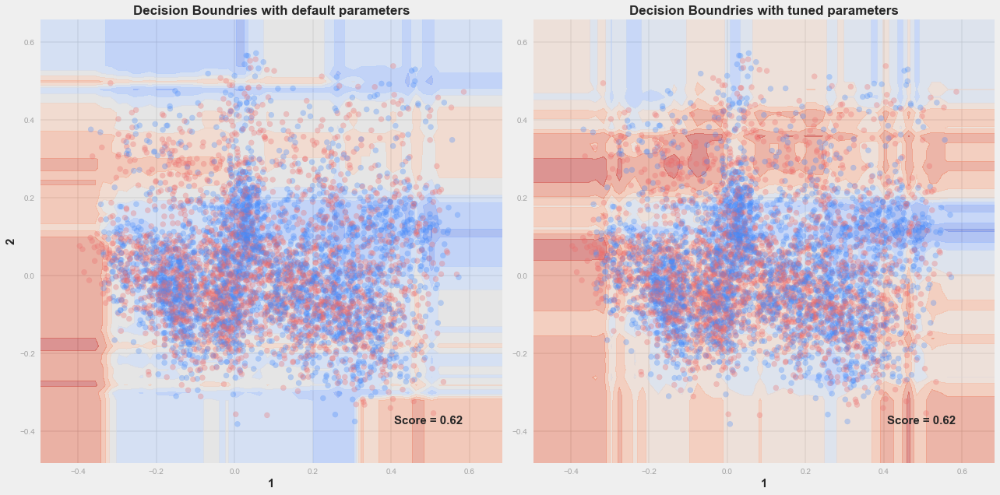

In [42]:
v1 = visuallize_tuning(grouped, 1, 'PCA')

stats = df_perf_xgb[df_perf_xgb['spa']==1].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[5], 'PCA', stats[0], stats[1], stats[2]))

param_xgb_pca = {'gamma':params['gamma'][2], 'subsample':params['subsample'][1], 
                 'reg_alpha':params['reg_alpha'][3]}.copy()
v2 = visuallize_decision_boundary(xgb, X_train_space[1][:5000], y_train[:5000], param_xgb_pca, [1,2])
vis.plt.show()

### c. SPCA feature space:


The performance evaluation of XGBoost with SPCA features are
bias:0.349
var:0.000032
expected loss:0.122091


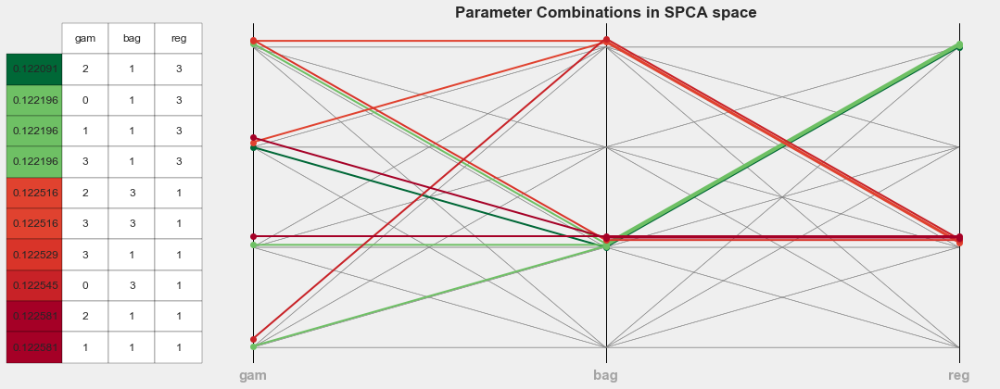

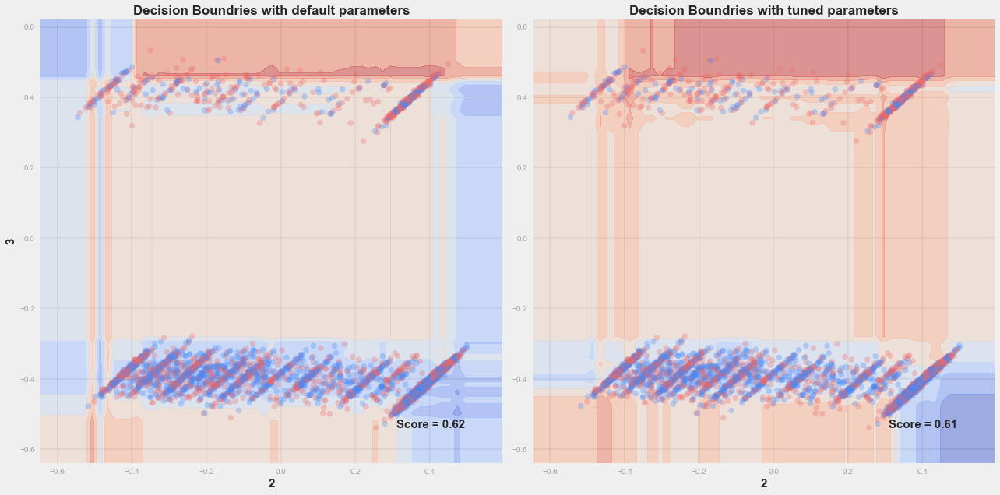

In [43]:
v1 = visuallize_tuning(grouped, 2, 'SPCA')

stats = df_perf_xgb[df_perf_xgb['spa']==2].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[5], 'SPCA', stats[0], stats[1], stats[2]))

param_xgb_spca = {'gamma':params['gamma'][2], 'subsample':params['subsample'][1], 
                  'reg_alpha':params['reg_alpha'][3]}.copy()
v2 = visuallize_decision_boundary(xgb, X_train_space[2][:5000], y_train[:5000], param_xgb_spca, [2,3])
vis.plt.show()

### d. factor analysis feature space:


The performance evaluation of XGBoost with FA features are
bias:0.356
var:0.000041
expected loss:0.126645


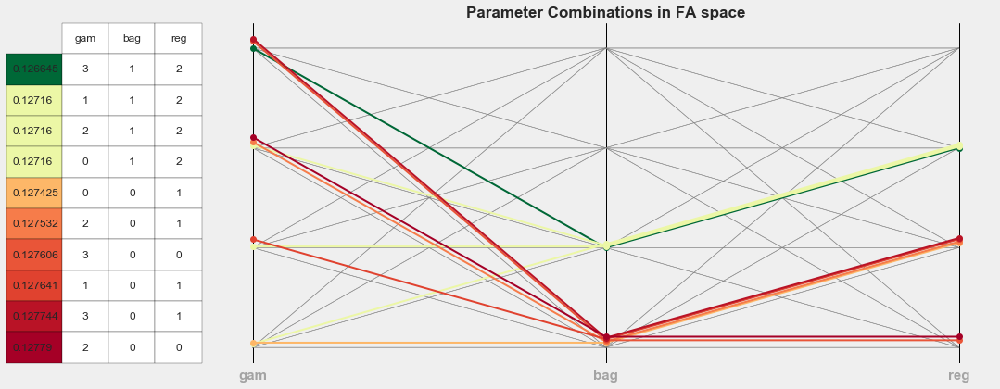

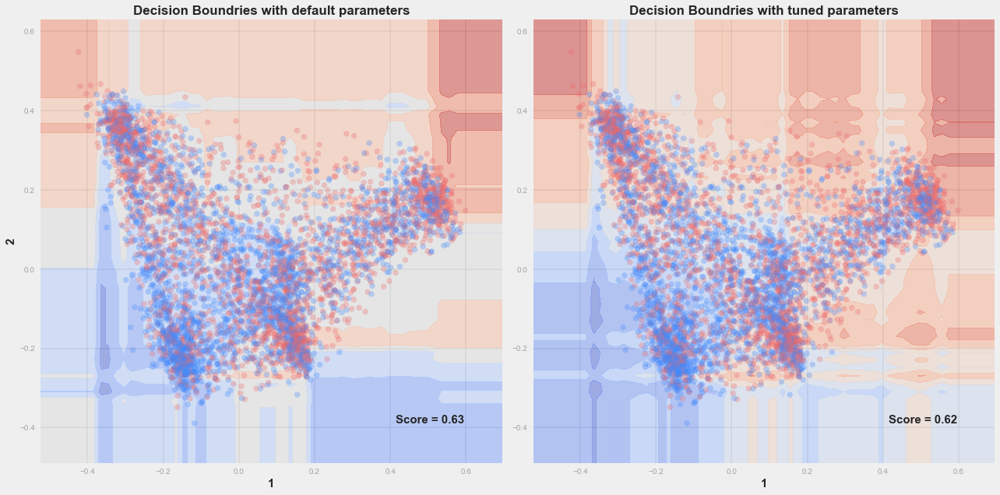

In [44]:
v1 = visuallize_tuning(grouped, 3, 'FA')

stats = df_perf_xgb[df_perf_xgb['spa']==3].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[5], 'FA', stats[0], stats[1], stats[2]))

param_xgb_fa = {'gamma':params['gamma'][3], 'subsample':params['subsample'][1], 
                'reg_alpha':params['reg_alpha'][2]}.copy()
v2 = visuallize_decision_boundary(xgb, X_train_space[3][:5000], y_train[:5000], param_xgb_fa, [1,2])
vis.plt.show()

### e. NMF feature space:


The performance evaluation of XGBoost with NMF features are
bias:0.366
var:0.000015
expected loss:0.133835


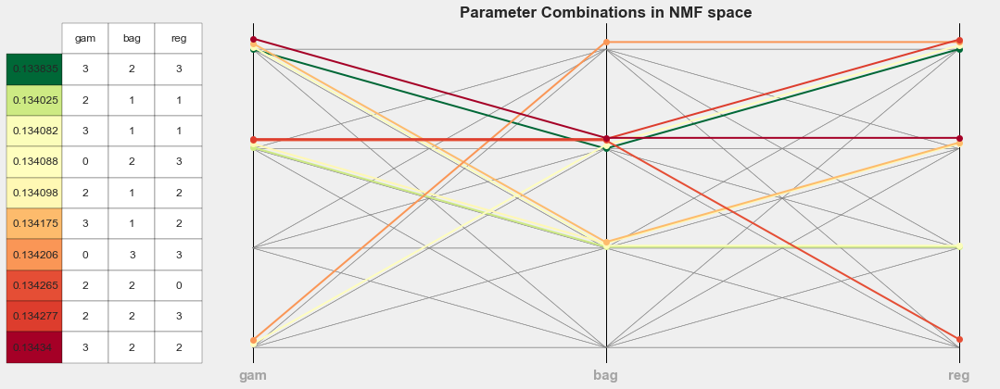

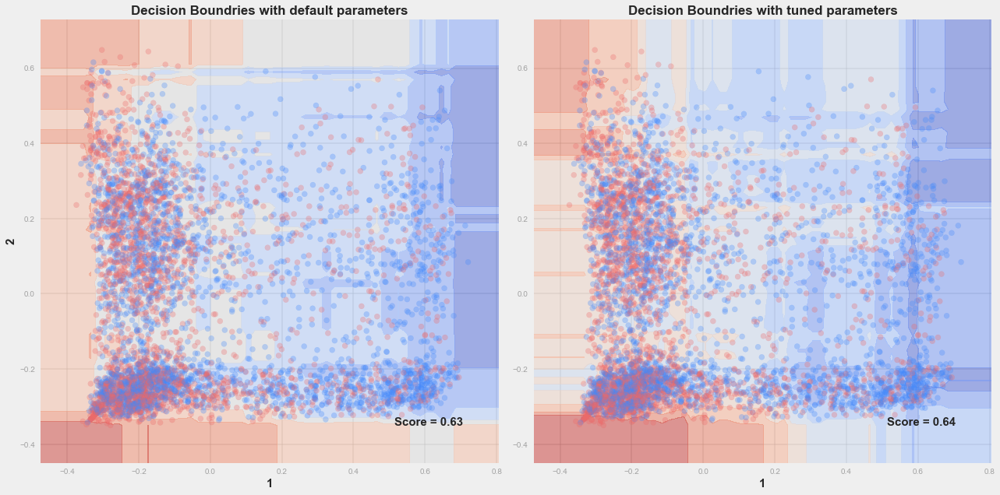

In [45]:
v1 = visuallize_tuning(grouped, 4, 'NMF')

stats = df_perf_xgb[df_perf_xgb['spa']==4].reset_index(drop=True).loc[0, ['bias', 'var', 'loss']]
perf_evaluations.append(list(stats.values))

print('\nThe performance evaluation of %s with %s features are\nbias:%.3f\nvar:%.6f\nexpected loss:%.6f' % 
      (clf_name[5], 'NMF', stats[0], stats[1], stats[2]))

param_xgb_nmf = {'gamma':params['gamma'][3], 'subsample':params['subsample'][2], 
                 'reg_alpha':params['reg_alpha'][3]}.copy()
v2 = visuallize_decision_boundary(xgb, X_train_space[4][:5000], y_train[:5000], param_xgb_nmf, [1,2])
vis.plt.show()

# 8. Compare performance evaluations:

Gather together all the performance evaluation we get from different classifiers in different space with best parameter setting for each of them. We can plot them out and compare them visually.

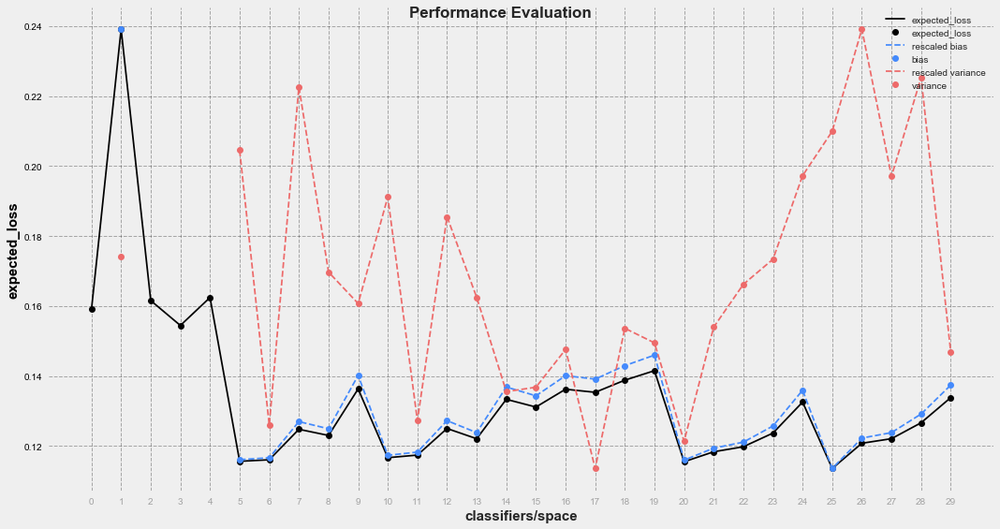

In [46]:
def rescale(attr):
    rng_0 = perfs['expected_loss'].max() - perfs['expected_loss'].min()
    rng_1 = perfs[attr].max() - perfs[attr].min()
    rescaled = (perfs[attr] - perfs[attr].min()) * (rng_0/rng_1) + perfs['expected_loss'].min()
    return rescaled

def dist_to_proba(dist):
    """ transform distances(to decision boundary) to prediction probabilities(n_samples * n_classes)
    """
    n_samples = dist.shape[0]
    proba = np.empty((n_samples,2))
    
    dist_min, dist_max = dist.min(), dist.max()
    
    for i in range(n_samples):
        if dist[i] < 0:
            proba[i,0] = 1 - ((dist_min - dist[i]) / dist_min)
            proba[i,1] = 1 - proba[i,0]
        else:
            proba[i,1] = 1 - ((dist_max - dist[i]) / dist_max)
            proba[i,0] = 1 - proba[i,1]
    
    return proba

def get_yPred(args):
    """ Visualize the confusion histogram of assign classifier on assigned data set.
    """
    clf, param, X_train, X_test = args
    model = clf(**param)
    model.fit(X_train, y_train.ravel())
    
    if hasattr(clf, "predict_proba"):
        yPred = model.predict_proba(X_test)
    else:
        yDist = model.decision_function(X_test)
        yPred = dist_to_proba(yDist)
    return yPred

perfs = deepcopy(perf_evaluations)
for i in range(len(perfs)):
    perfs[i].extend([space_name[i%5], clf_name[i//5]])

cols = ['bias', 'variance', 'expected_loss', 'space', 'classifier']
perfs = pd.DataFrame(perfs, columns=cols)

# visuallize loss var and bias 
v = vis.Visual(1, 1, figsize=(15, 8))
v.lines(perfs.index, [perfs['expected_loss'], rescale('bias'), rescale('variance')])

In [47]:
perfs.sort_values('expected_loss').head(n=10)

,bias,variance,expected_loss,space,classifier
25,0.336963,0.000036,0.113580,original,XGBoost
20,0.339852,0.000006,0.115506,original,Random Forest
5,0.340000,0.000034,0.115634,original,Logistic Regression
6,0.340667,0.000008,0.116062,PCA,Logistic Regression
10,0.341519,0.000030,0.116665,original,SVM
11,0.342630,0.000008,0.117404,PCA,SVM
21,0.344000,0.000017,0.118353,PCA,Random Forest
22,0.346074,0.000021,0.119789,sparsePCA,Random Forest
26,0.347481,0.000046,0.120789,PCA,XGBoost
13,0.349370,0.000020,0.122080,factorAnalysis,SVM


From the plotting we can easily distinguish good models from the bad ones. The classifier we want should have low bias as well as low performance std. So the 10 classifiers listed above are better than the others. What is interesting about this result is that most of the classifiers selected prefers original features and PCA features.

Although we can simply select the top one, which is XGB in original feature space, the expected loss the other top classifiers achieved are also close. And we still have the problem of possible unbalanced prediction. To be "save", we  take the top 6 classifiers and further look into the correct as well as wrong classifications they made.

### Decision Confidence Compare:

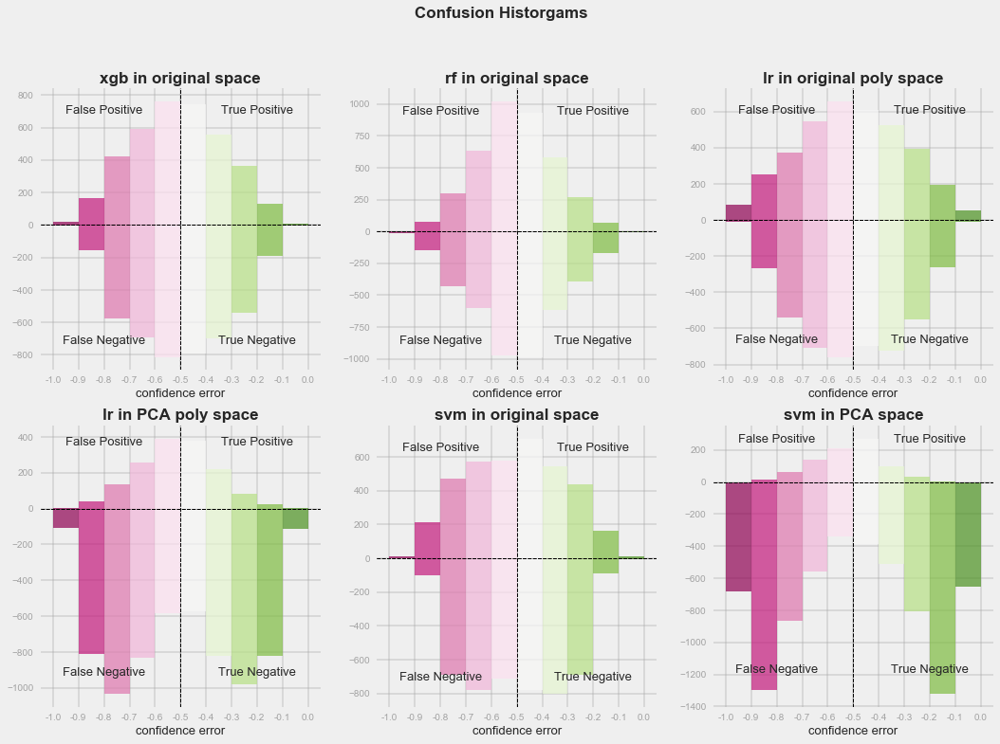

In [48]:
"""
param_svm_ori.update({'probability':True}); param_svm_pca.update({'probability':True})
args = [[xgb, param_xgb_ori, X_train_space[0], X_test_space[0]],
        [rf, param_rf_ori, X_train_space[0], X_test_space[0]],
        [lr, param_lr_ori, X_train_polyspace[0], X_test_polyspace[0]],
        [lr, param_lr_pca, X_train_polyspace[1], X_test_polyspace[1]],
        [svc, param_svm_ori, X_train_space[0], X_test_space[0]],
        [svc, param_svm_pca, X_train_space[1], X_test_space[1]]]

y_preds = []
for arg in args: y_preds.append(get_yPred(arg)) 

with open("data/data/performances/y_pred", 'wb') as f:
    pickle.dump(y_preds, f)
"""
with open("data/performances/y_pred", 'rb') as f:
    p_pred = pickle.load(f)

v = vis.Visual(2, 3, figsize=(18, 12))
v.confusion_hists(y_test, p_pred, ['xgb', 'rf', 'lr', 'lr', 'svm', 'svm'], 
                  ['original', 'original', 'original poly', 'PCA poly', 'original', 'PCA'])

These confusion histograms , which are the detail version of confusion matrices, show us how confident those 6 classifiers are when they are correct or wrong. For example, in the case of xgb classifier in original space, it does a good job in false predictions because it is less confident about most of the false predictions. On the other hand, it is less sure about most of the true predictions as well, which is not what we desired.

From this plotting, we can easily ditch the 2 classifiers using PCA features because they label most of their prediction as negative. The other classifiers all have similar confidence distribution, so we can select the one with best expected loss, which is extra gradient boost using original features as the best model.